# Style transfer using GAN
This notebook is used to prepare the capstone project 'Style transfer using GAN'

In [1]:
#Importing all the required libraries

from google.colab import drive
drive.mount('/content/drive')
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import imageio
import glob
import pathlib
import PIL 

from PIL import Image
from skimage.transform import resize
from keras.utils.vis_utils import plot_model

import os
path = '/content'
os.chdir(path)

Mounted at /content/drive


## Data understanding
Importing the images & creating two seperate datasets. The input shape for image is changed to (256, 256)


In [3]:
filel = glob.glob('/content/drive/MyDrive/dataset/Tr1/TrainT1/*.png')
tr1 = np.array([np.array(Image.open(fname)) for fname in filel])

In [4]:
file2l = glob.glob('/content/drive/MyDrive/dataset/Tr2/TrainT2/*.png')
tr2 = np.array([np.array(Image.open(fname2)) for fname2 in file2l])

In [5]:
b_size= 16

(43, 217, 181)


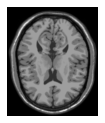

In [6]:
imgs = tr1
print(imgs.shape)
plt.figure(figsize=(2, 2))
plt.imshow(imgs[0], cmap='gray')
plt.axis('off')
plt.show()

(46, 217, 181)


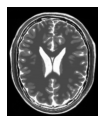

In [7]:
imgs = tr2
print(imgs.shape)
plt.figure(figsize=(2, 2))
plt.imshow(imgs[0], cmap='gray')
plt.axis('off')
plt.show()

## Image Processing 
1.Creating a function to process images with normalisation

2.Applying the function to both the datasets 

3.Visualising the MRI images after processing




In [8]:
# normalizing the images to [-1, 1]
def normalize(image):
    image = (image/127.5) - 1.0
    return image

In [9]:
def preprocess_image_train(image):
    image = normalize(image)
    image = tf.image.random_flip_left_right(image)
    return image

In [10]:
#normalising and flipping the images
pre_tr1 = preprocess_image_train(tr1)
pre_tr2 = preprocess_image_train(tr2)

In [11]:
#resizing and reshaping the arrays for compatibility with tensor flow library for tr1 dataset
tr1_dat = np.zeros((pre_tr1.shape[0], 256, 256))
for i, im in enumerate(pre_tr1):
  tr1_dat[i, :, :] = resize(im, (256,256))
tr1_dat = tr1_dat.reshape(tr1_dat.shape[0], 256, 256, 1).astype('float32')
tr1_dat.shape

(43, 256, 256, 1)

In [12]:
#resizing and reshaping the arrays for compatibility with tensor flow library preparation for tr2 dataset
tr2_dat = np.zeros((pre_tr2.shape[0], 256, 256))
for i, im in enumerate(pre_tr2):
  tr2_dat[i, :, :] = resize(im, (256,256))
tr2_dat = tr2_dat.reshape(tr2_dat.shape[0], 256, 256, 1).astype('float32')
tr2_dat.shape

(46, 256, 256, 1)

In [13]:
#converting array to a tensor with batch size = 16
tr1_dat = tf.data.Dataset.from_tensor_slices(tr1_dat).shuffle(tr1_dat.shape[0], seed =123).batch(b_size)
tr2_dat = tf.data.Dataset.from_tensor_slices(tr2_dat).shuffle(tr2_dat.shape[0], seed =123).batch(b_size)

In [14]:
sample_tr1 = next(iter(tr1_dat))
sample_tr2 = next(iter(tr2_dat))

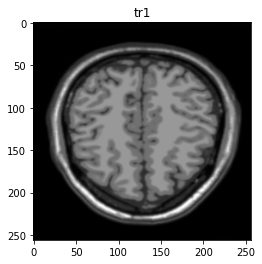

In [15]:
#visualising the dataset tf1 images
plt.title('tr1')
plt.imshow(sample_tr1[0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')

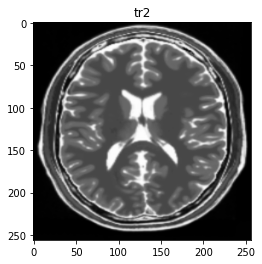

In [16]:
#visualising the dataset tf2 images
plt.title('tr2')
plt.imshow(sample_tr2[0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')

## Model Building & Training
The architecture of generator is a modified U-Net.

1.Creating Generator & Discriminator

2.Defining the loss functions

3.Creating the train_step function

In [17]:
class InstanceNormalization(tf.keras.layers.Layer):
    def __init__(self, epsilon=1e-5):
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    def call(self, x):
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    if apply_norm:
        result.add(InstanceNormalization())
    result.add(tf.keras.layers.LeakyReLU())
    return result

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    result.add(InstanceNormalization())
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    result.add(tf.keras.layers.ReLU())
    return result

In [18]:
def unet_generator():
    down_stack = [
                  downsample(64,4,False),
                  downsample(64,4),
                  downsample(128,4),
                  downsample(128,4),
                  downsample(128,4),
                  downsample(256,4)
    ]
    up_stack = [
                upsample(256, 4, True),
                upsample(128, 4, True),
                upsample(128, 4),
                upsample(128, 4),
                upsample(64, 4),
                upsample(64, 4)
    ]
        
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 256, 256, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[256, 256, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

In [19]:
generator_g = unet_generator()
generator_f = unet_generator()

In [20]:
generator_f.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
sequential_12 (Sequential)      (None, 128, 128, 64) 1024        input_2[0][0]                    
__________________________________________________________________________________________________
sequential_13 (Sequential)      (None, 64, 64, 64)   65664       sequential_12[0][0]              
__________________________________________________________________________________________________
sequential_14 (Sequential)      (None, 32, 32, 128)  131328      sequential_13[0][0]              
____________________________________________________________________________________________

In [21]:
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    inp = tf.keras.layers.Input(shape=[256, 256, 1], name='input_image')
    x = inp
    down1 = downsample(64,4, False)(x)
    down2 = downsample(128,4)(down1)
    down3 = downsample(256,4)(down2)
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) # (bs, 31, 31, 512)
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)
    return tf.keras.Model(inputs = inp, outputs=last)

In [22]:
discriminator_x = discriminator()
discriminator_y = discriminator()

In [23]:
discriminator_x.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_image (InputLayer)     [(None, 256, 256, 1)]     0         
_________________________________________________________________
sequential_24 (Sequential)   (None, 128, 128, 64)      1024      
_________________________________________________________________
sequential_25 (Sequential)   (None, 64, 64, 128)       131328    
_________________________________________________________________
sequential_26 (Sequential)   (None, 32, 32, 256)       524800    
_________________________________________________________________
zero_padding2d (ZeroPadding2 (None, 34, 34, 256)       0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 31, 31, 512)       2097152   
_________________________________________________________________
instance_normalization_24 (I (None, 31, 31, 512)       1024

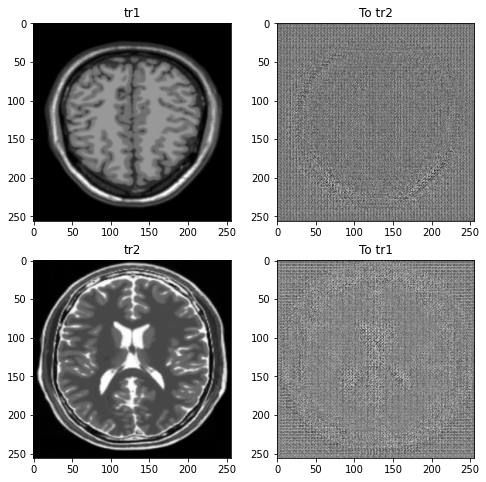

In [24]:
to_tr2 = generator_g(sample_tr1)
to_tr1 = generator_f(sample_tr2)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_tr1, to_tr2, sample_tr2, to_tr1]
title = ['tr1', 'To tr2', 'tr2', 'To tr1']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    if i % 2 == 0:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
    else:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 * contrast + 0.5, cmap='gray')
plt.show()

In [25]:
LAMBDA = 12.0

In [26]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [27]:
def discriminator_loss(rl, gener):
    real_loss = loss_obj(tf.ones_like(rl), rl)
    generated_loss = loss_obj(tf.zeros_like(gener),gener)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5

In [28]:
def generator_loss(gener):
    return loss_obj(tf.ones_like(gener), gener)

In [29]:
def calc_cycle_loss(real_im, cycled_im):
    loss1 = tf.reduce_mean(tf.abs(real_im - cycled_im))
    return LAMBDA * loss1

In [30]:
def identity_loss(real_im, same_im):
    loss = tf.reduce_mean(tf.abs(real_im - same_im))
    return LAMBDA * 0.5 * loss

In [31]:
generator_g_optimizer = tf.keras.optimizers.Adam(0.0001, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(0.0001, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(0.0001, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(0.0001, beta_1=0.5)

In [32]:
EPOCHS = 150

In [33]:
checkpoint_path = "./Trained_model"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=EPOCHS)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

In [34]:
def generate_images(model, test_input, expected_output):
    prediction = model(test_input)
    plt.figure(figsize=(10, 10))
    display_list = [test_input[0], prediction[0], expected_output[0]]
    title = ['Input Image', 'Predicted Image', 'Expected Image']
    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
        plt.axis('off')
    plt.show()

In [35]:
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator_G translates X -> Y
        # Generator_F translates Y -> X.
        fake_y = generator_g(real_x, training = True)
        cycled_x = generator_f(fake_y, training = True)
        
        fake_x = generator_f(real_y, training = True)
        cycled_y = generator_g(fake_x, training = True)
        
        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training = True)
        same_y = generator_g(real_y, training = True)
        
        disc_real_x = discriminator_x(real_x, training = True)
        disc_real_y = discriminator_y(real_y, training = True)
        
        disc_fake_x = discriminator_x(fake_x, training = True)
        disc_fake_y = discriminator_y(fake_y, training = True)
        
        # calculating the loss
        gen_g_loss = generator_loss(disc_fake_x)
        gen_f_loss = generator_loss(disc_fake_y)
        
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
        
        # Total generator loss = adversarial loss + cycle loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)
        
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
        
    # Calculating the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
    
    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)
    
    # Applying the gradients to the optimizer
    
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))

    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))
    


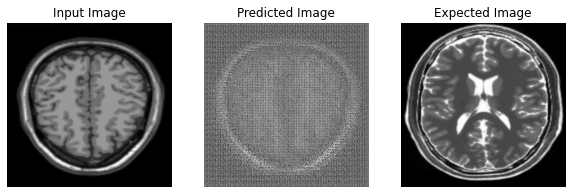

Saving checkpoint for epoch 0 at ./Trained_model/ckpt-1


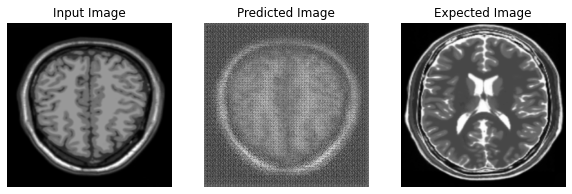

Saving checkpoint for epoch 1 at ./Trained_model/ckpt-2


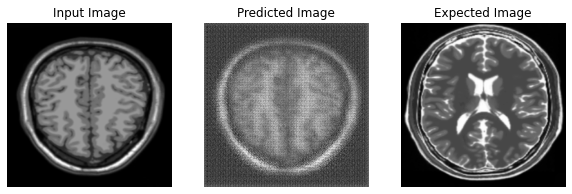

Saving checkpoint for epoch 2 at ./Trained_model/ckpt-3


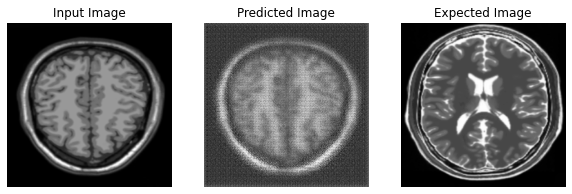

Saving checkpoint for epoch 3 at ./Trained_model/ckpt-4


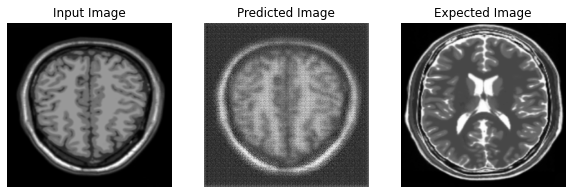

Saving checkpoint for epoch 4 at ./Trained_model/ckpt-5


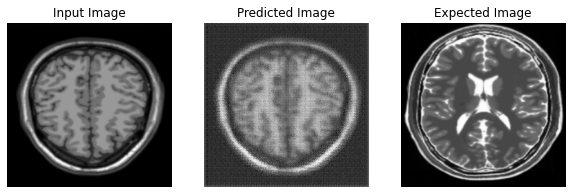

Saving checkpoint for epoch 5 at ./Trained_model/ckpt-6


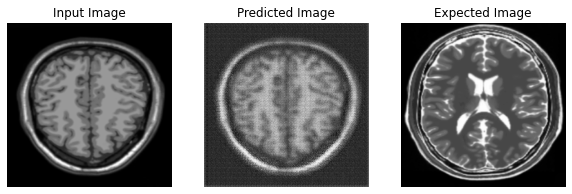

Saving checkpoint for epoch 6 at ./Trained_model/ckpt-7


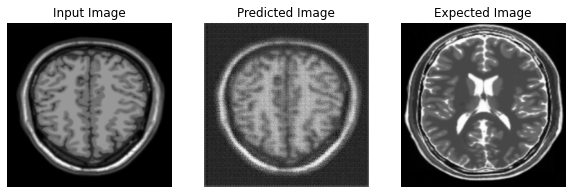

Saving checkpoint for epoch 7 at ./Trained_model/ckpt-8


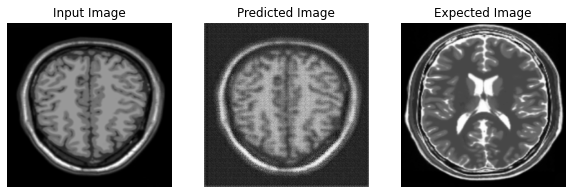

Saving checkpoint for epoch 8 at ./Trained_model/ckpt-9


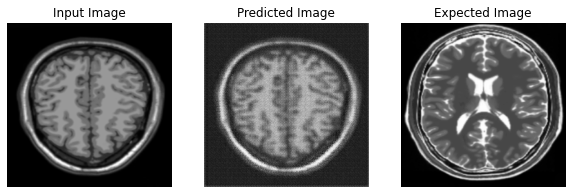

Saving checkpoint for epoch 9 at ./Trained_model/ckpt-10


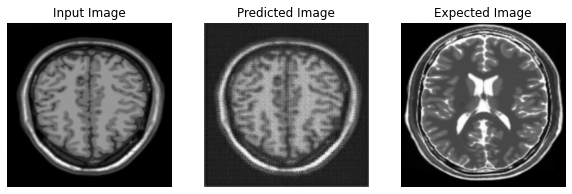

Saving checkpoint for epoch 10 at ./Trained_model/ckpt-11


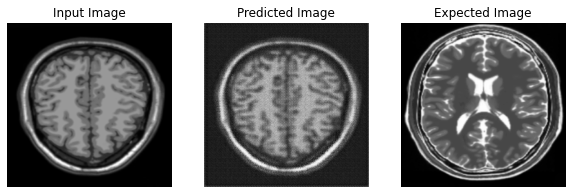

Saving checkpoint for epoch 11 at ./Trained_model/ckpt-12


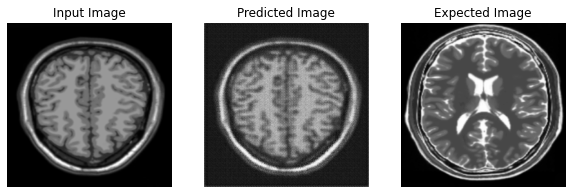

Saving checkpoint for epoch 12 at ./Trained_model/ckpt-13


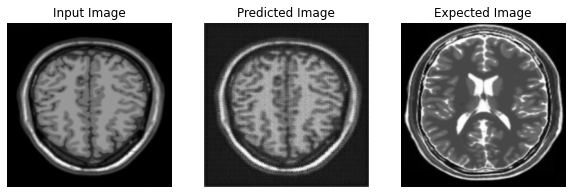

Saving checkpoint for epoch 13 at ./Trained_model/ckpt-14


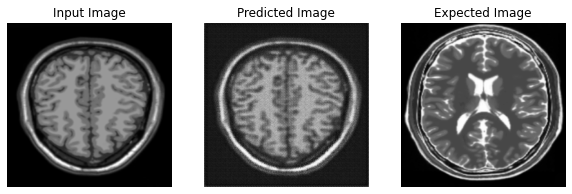

Saving checkpoint for epoch 14 at ./Trained_model/ckpt-15


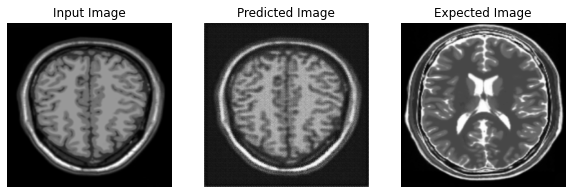

Saving checkpoint for epoch 15 at ./Trained_model/ckpt-16


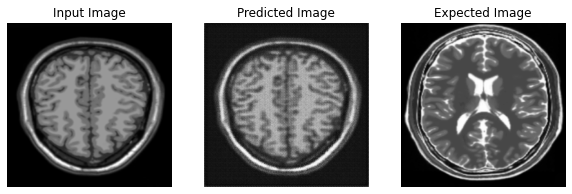

Saving checkpoint for epoch 16 at ./Trained_model/ckpt-17


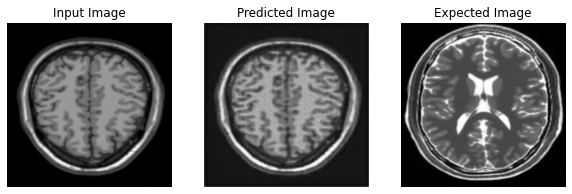

Saving checkpoint for epoch 17 at ./Trained_model/ckpt-18


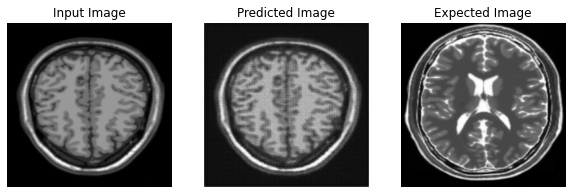

Saving checkpoint for epoch 18 at ./Trained_model/ckpt-19


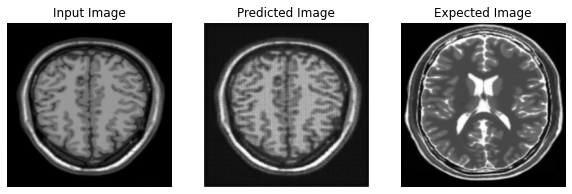

Saving checkpoint for epoch 19 at ./Trained_model/ckpt-20


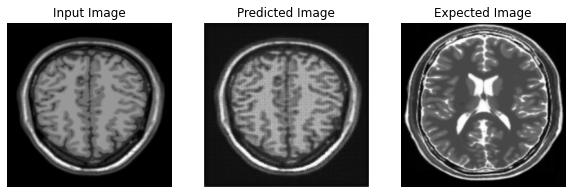

Saving checkpoint for epoch 20 at ./Trained_model/ckpt-21


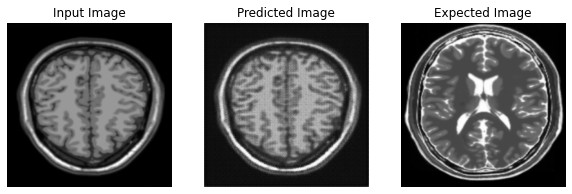

Saving checkpoint for epoch 21 at ./Trained_model/ckpt-22


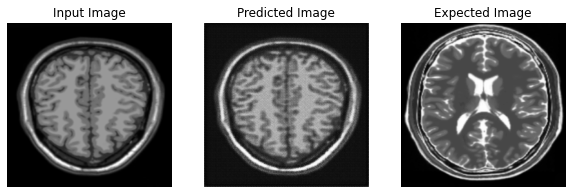

Saving checkpoint for epoch 22 at ./Trained_model/ckpt-23


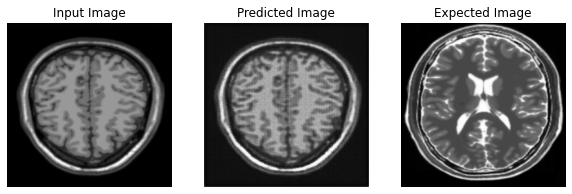

Saving checkpoint for epoch 23 at ./Trained_model/ckpt-24


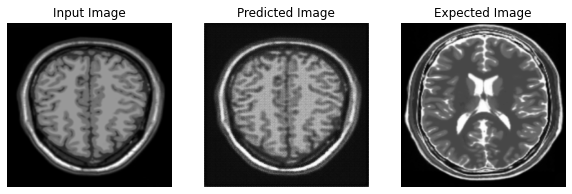

Saving checkpoint for epoch 24 at ./Trained_model/ckpt-25


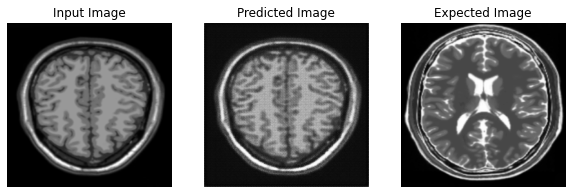

Saving checkpoint for epoch 25 at ./Trained_model/ckpt-26


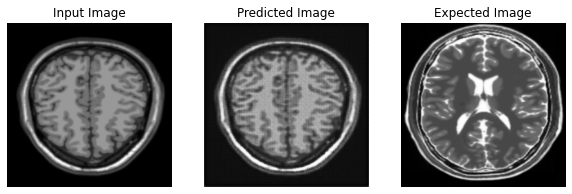

Saving checkpoint for epoch 26 at ./Trained_model/ckpt-27


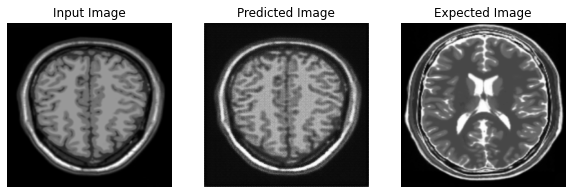

Saving checkpoint for epoch 27 at ./Trained_model/ckpt-28


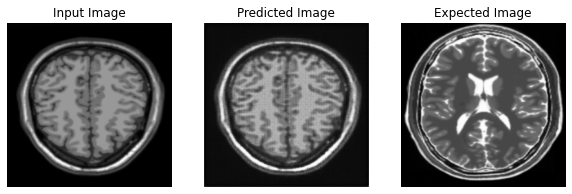

Saving checkpoint for epoch 28 at ./Trained_model/ckpt-29


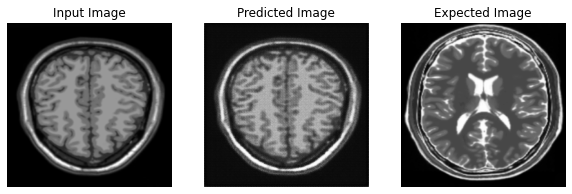

Saving checkpoint for epoch 29 at ./Trained_model/ckpt-30


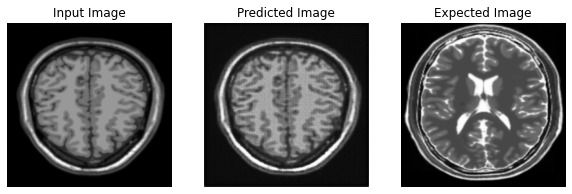

Saving checkpoint for epoch 30 at ./Trained_model/ckpt-31


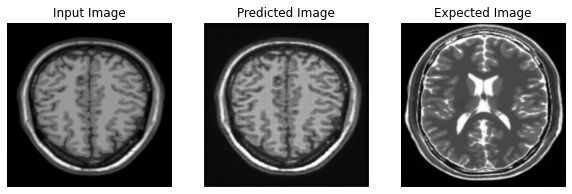

Saving checkpoint for epoch 31 at ./Trained_model/ckpt-32


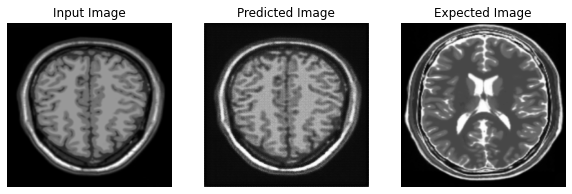

Saving checkpoint for epoch 32 at ./Trained_model/ckpt-33


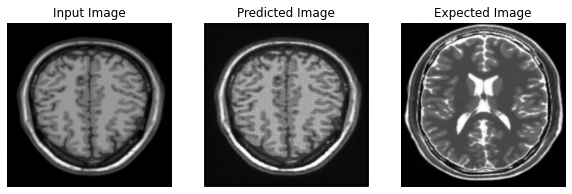

Saving checkpoint for epoch 33 at ./Trained_model/ckpt-34


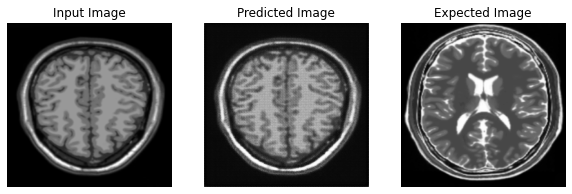

Saving checkpoint for epoch 34 at ./Trained_model/ckpt-35


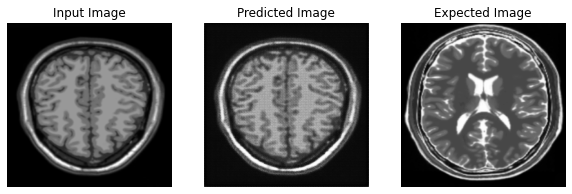

Saving checkpoint for epoch 35 at ./Trained_model/ckpt-36


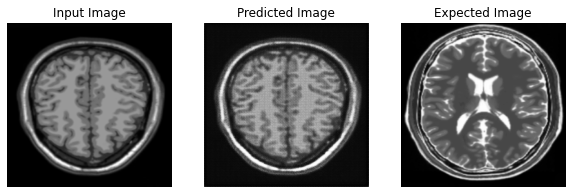

Saving checkpoint for epoch 36 at ./Trained_model/ckpt-37


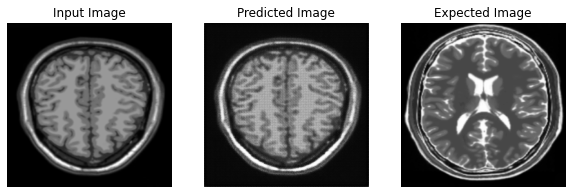

Saving checkpoint for epoch 37 at ./Trained_model/ckpt-38


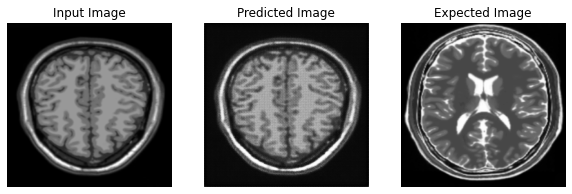

Saving checkpoint for epoch 38 at ./Trained_model/ckpt-39


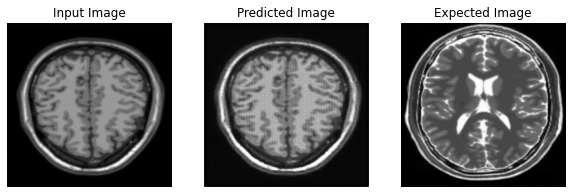

Saving checkpoint for epoch 39 at ./Trained_model/ckpt-40


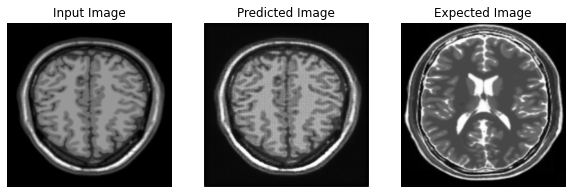

Saving checkpoint for epoch 40 at ./Trained_model/ckpt-41


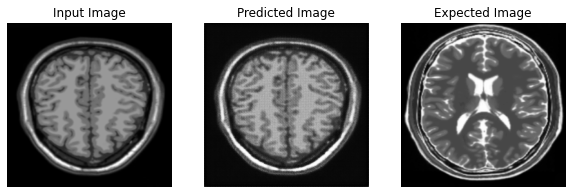

Saving checkpoint for epoch 41 at ./Trained_model/ckpt-42


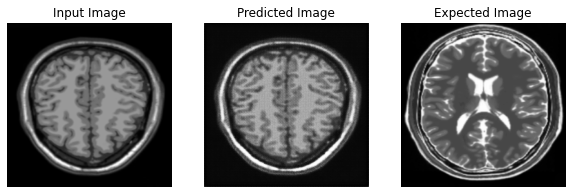

Saving checkpoint for epoch 42 at ./Trained_model/ckpt-43


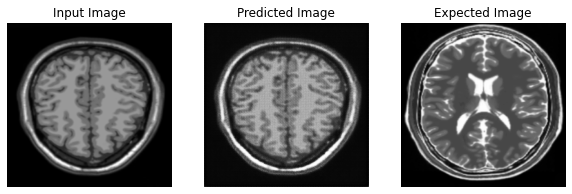

Saving checkpoint for epoch 43 at ./Trained_model/ckpt-44


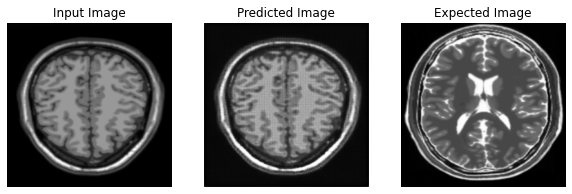

Saving checkpoint for epoch 44 at ./Trained_model/ckpt-45


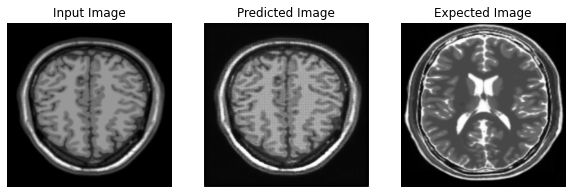

Saving checkpoint for epoch 45 at ./Trained_model/ckpt-46


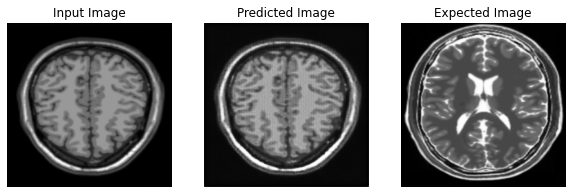

Saving checkpoint for epoch 46 at ./Trained_model/ckpt-47


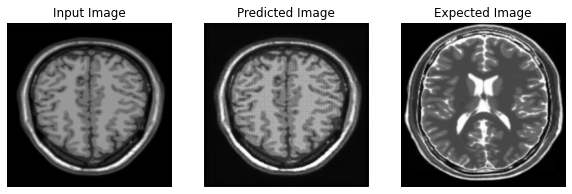

Saving checkpoint for epoch 47 at ./Trained_model/ckpt-48


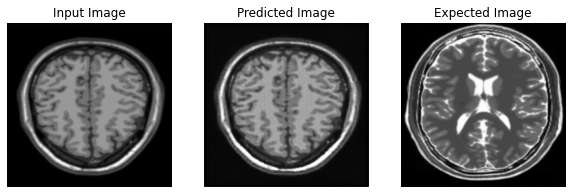

Saving checkpoint for epoch 48 at ./Trained_model/ckpt-49


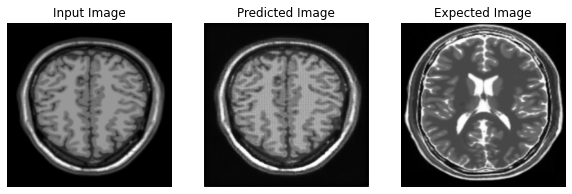

Saving checkpoint for epoch 49 at ./Trained_model/ckpt-50


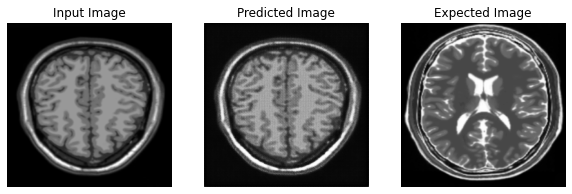

Saving checkpoint for epoch 50 at ./Trained_model/ckpt-51


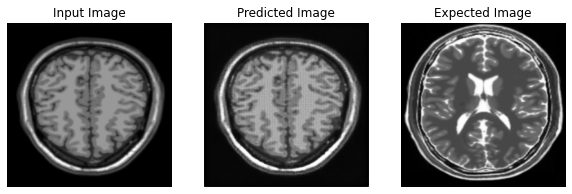

Saving checkpoint for epoch 51 at ./Trained_model/ckpt-52


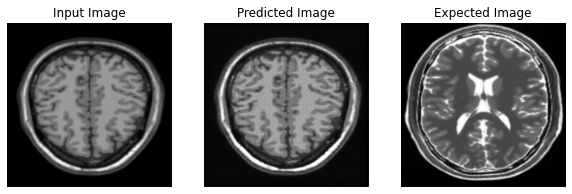

Saving checkpoint for epoch 52 at ./Trained_model/ckpt-53


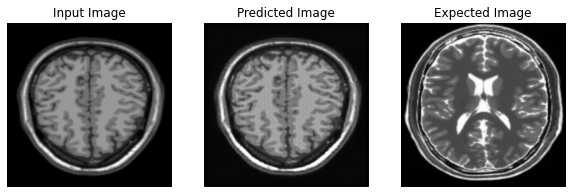

Saving checkpoint for epoch 53 at ./Trained_model/ckpt-54


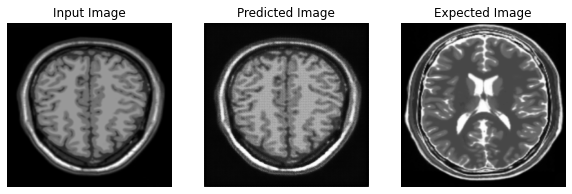

Saving checkpoint for epoch 54 at ./Trained_model/ckpt-55


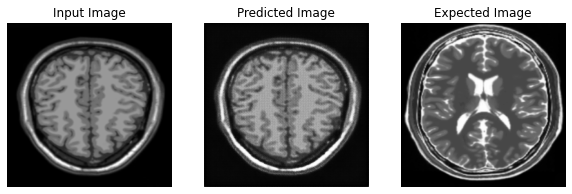

Saving checkpoint for epoch 55 at ./Trained_model/ckpt-56


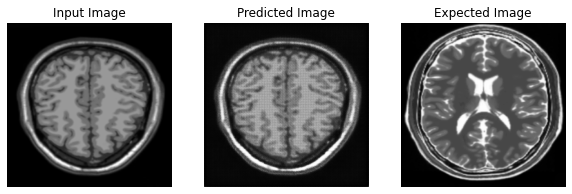

Saving checkpoint for epoch 56 at ./Trained_model/ckpt-57


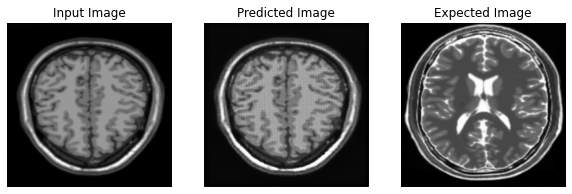

Saving checkpoint for epoch 57 at ./Trained_model/ckpt-58


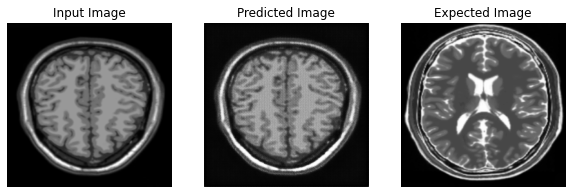

Saving checkpoint for epoch 58 at ./Trained_model/ckpt-59


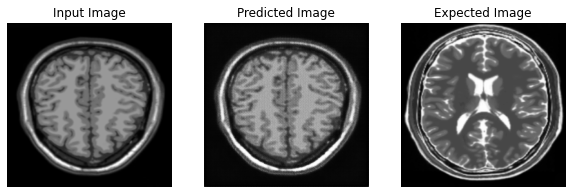

Saving checkpoint for epoch 59 at ./Trained_model/ckpt-60


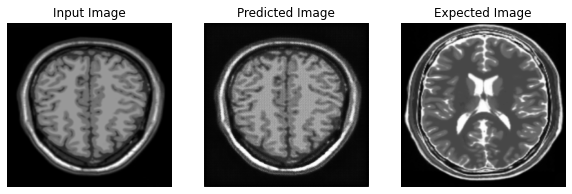

Saving checkpoint for epoch 60 at ./Trained_model/ckpt-61


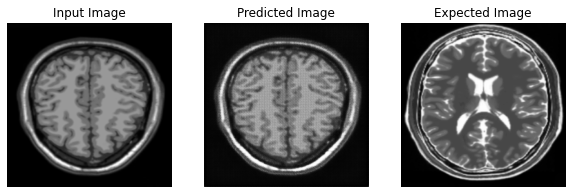

Saving checkpoint for epoch 61 at ./Trained_model/ckpt-62


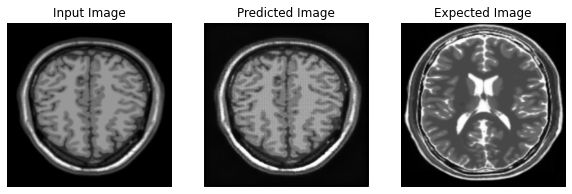

Saving checkpoint for epoch 62 at ./Trained_model/ckpt-63


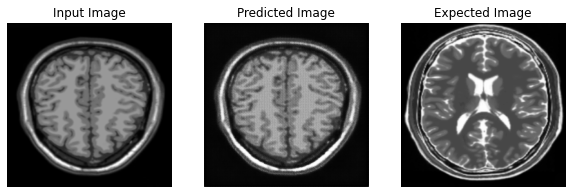

Saving checkpoint for epoch 63 at ./Trained_model/ckpt-64


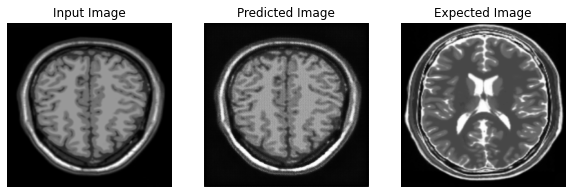

Saving checkpoint for epoch 64 at ./Trained_model/ckpt-65


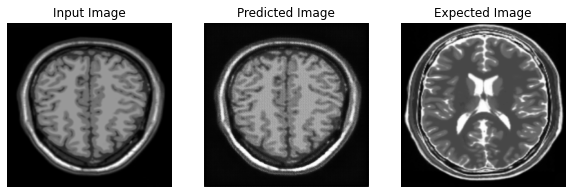

Saving checkpoint for epoch 65 at ./Trained_model/ckpt-66


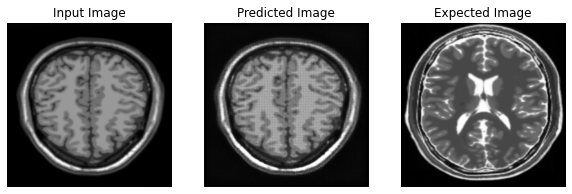

Saving checkpoint for epoch 66 at ./Trained_model/ckpt-67


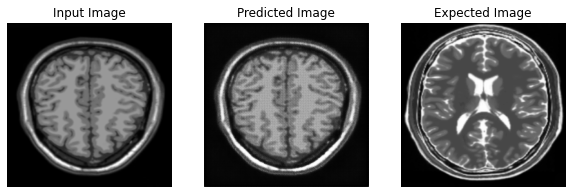

Saving checkpoint for epoch 67 at ./Trained_model/ckpt-68


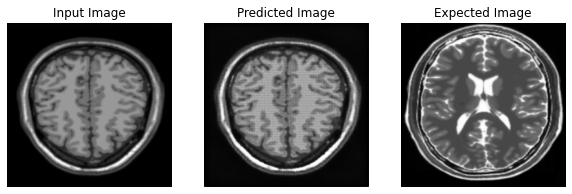

Saving checkpoint for epoch 68 at ./Trained_model/ckpt-69


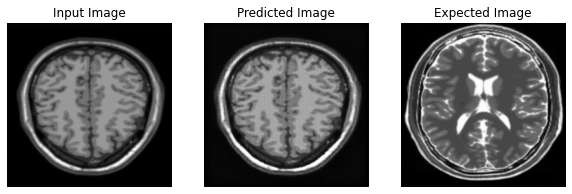

Saving checkpoint for epoch 69 at ./Trained_model/ckpt-70


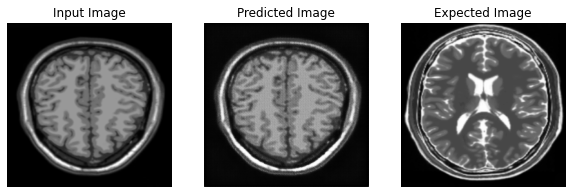

Saving checkpoint for epoch 70 at ./Trained_model/ckpt-71


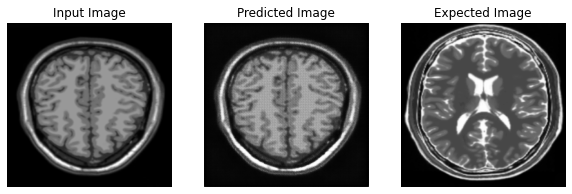

Saving checkpoint for epoch 71 at ./Trained_model/ckpt-72


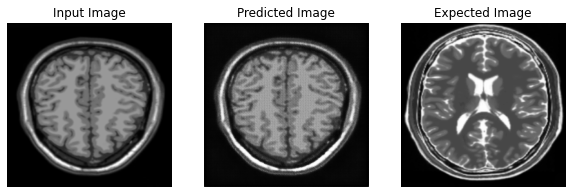

Saving checkpoint for epoch 72 at ./Trained_model/ckpt-73


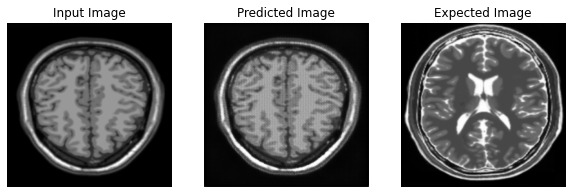

Saving checkpoint for epoch 73 at ./Trained_model/ckpt-74


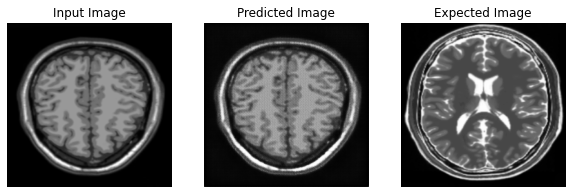

Saving checkpoint for epoch 74 at ./Trained_model/ckpt-75


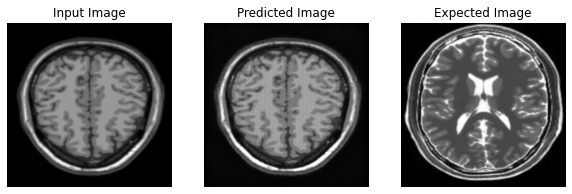

Saving checkpoint for epoch 75 at ./Trained_model/ckpt-76


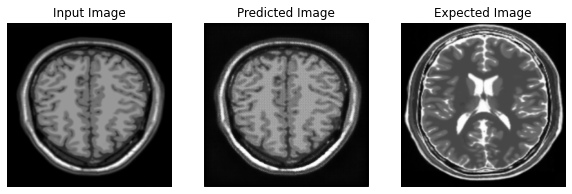

Saving checkpoint for epoch 76 at ./Trained_model/ckpt-77


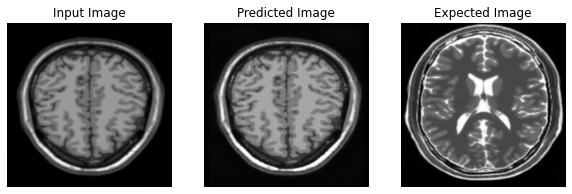

Saving checkpoint for epoch 77 at ./Trained_model/ckpt-78


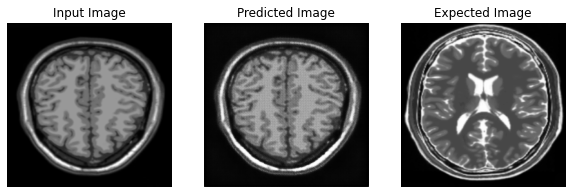

Saving checkpoint for epoch 78 at ./Trained_model/ckpt-79


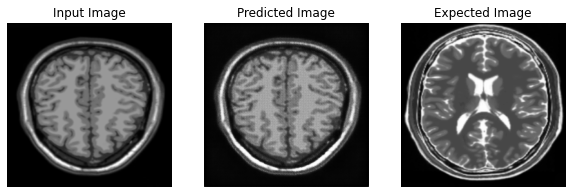

Saving checkpoint for epoch 79 at ./Trained_model/ckpt-80


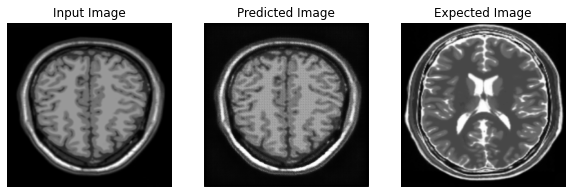

Saving checkpoint for epoch 80 at ./Trained_model/ckpt-81


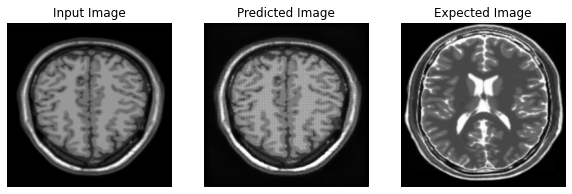

Saving checkpoint for epoch 81 at ./Trained_model/ckpt-82


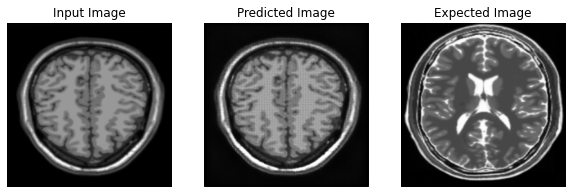

Saving checkpoint for epoch 82 at ./Trained_model/ckpt-83


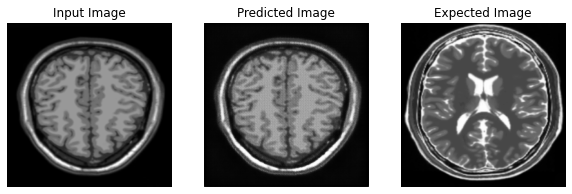

Saving checkpoint for epoch 83 at ./Trained_model/ckpt-84


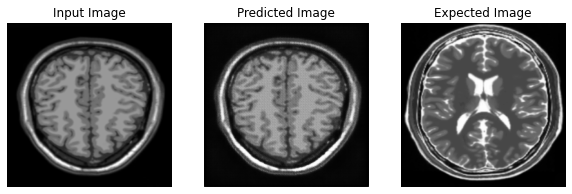

Saving checkpoint for epoch 84 at ./Trained_model/ckpt-85


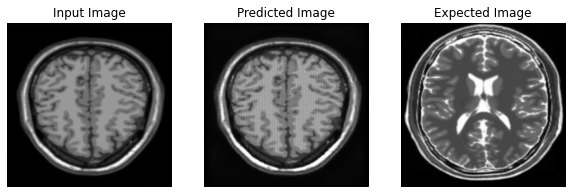

Saving checkpoint for epoch 85 at ./Trained_model/ckpt-86


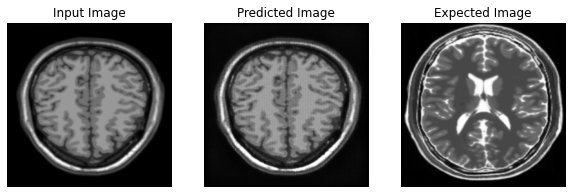

Saving checkpoint for epoch 86 at ./Trained_model/ckpt-87


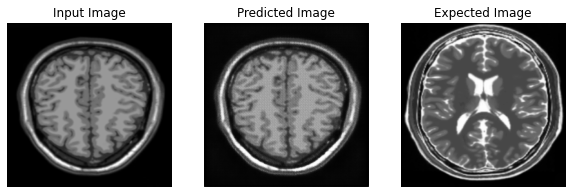

Saving checkpoint for epoch 87 at ./Trained_model/ckpt-88


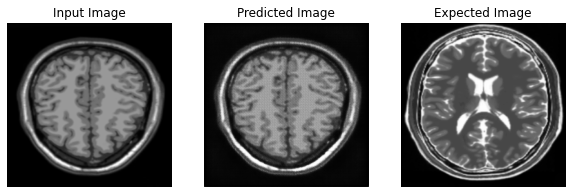

Saving checkpoint for epoch 88 at ./Trained_model/ckpt-89


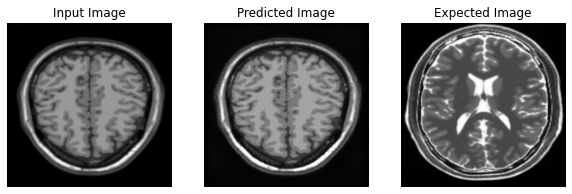

Saving checkpoint for epoch 89 at ./Trained_model/ckpt-90


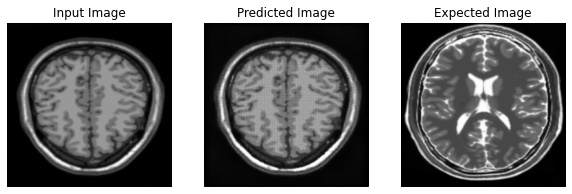

Saving checkpoint for epoch 90 at ./Trained_model/ckpt-91


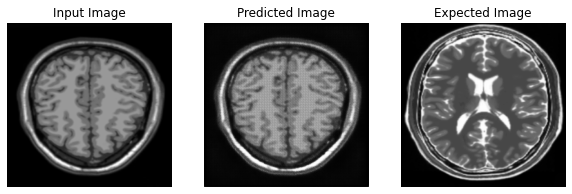

Saving checkpoint for epoch 91 at ./Trained_model/ckpt-92


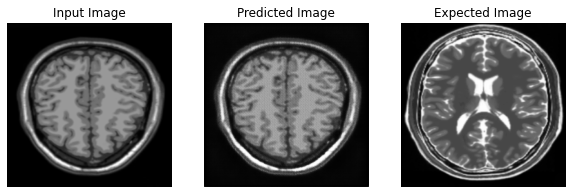

Saving checkpoint for epoch 92 at ./Trained_model/ckpt-93


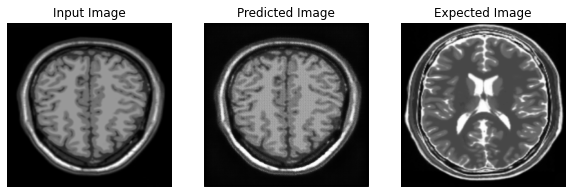

Saving checkpoint for epoch 93 at ./Trained_model/ckpt-94


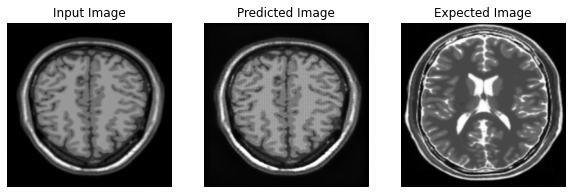

Saving checkpoint for epoch 94 at ./Trained_model/ckpt-95


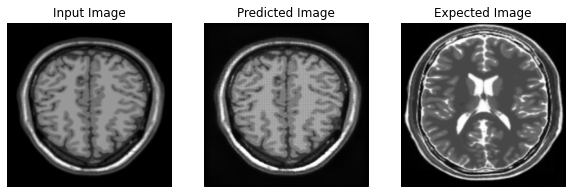

Saving checkpoint for epoch 95 at ./Trained_model/ckpt-96


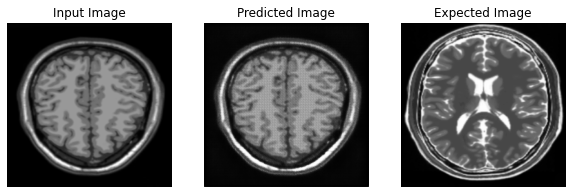

Saving checkpoint for epoch 96 at ./Trained_model/ckpt-97


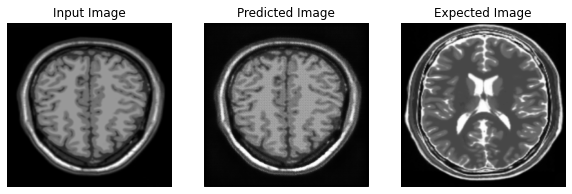

Saving checkpoint for epoch 97 at ./Trained_model/ckpt-98


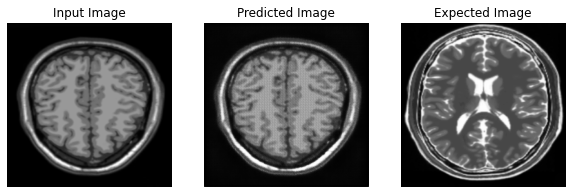

Saving checkpoint for epoch 98 at ./Trained_model/ckpt-99


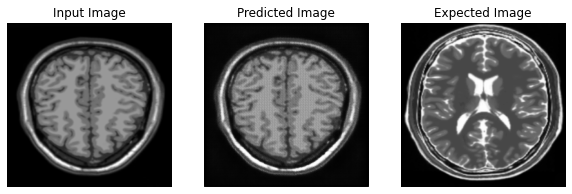

Saving checkpoint for epoch 99 at ./Trained_model/ckpt-100


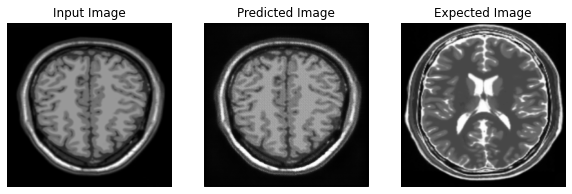

Saving checkpoint for epoch 100 at ./Trained_model/ckpt-101


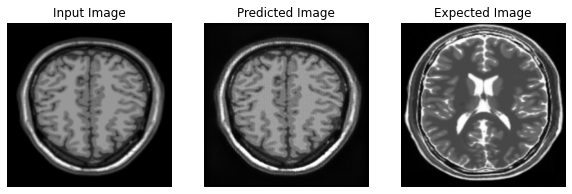

Saving checkpoint for epoch 101 at ./Trained_model/ckpt-102


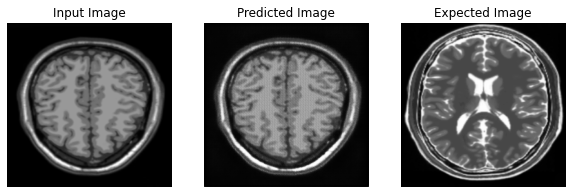

Saving checkpoint for epoch 102 at ./Trained_model/ckpt-103


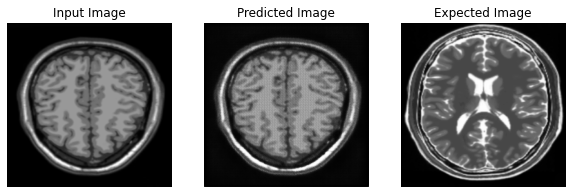

Saving checkpoint for epoch 103 at ./Trained_model/ckpt-104


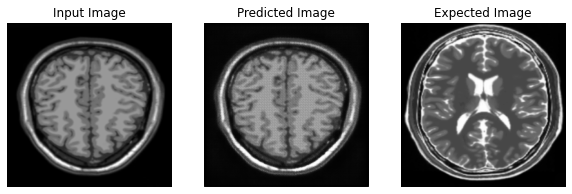

Saving checkpoint for epoch 104 at ./Trained_model/ckpt-105


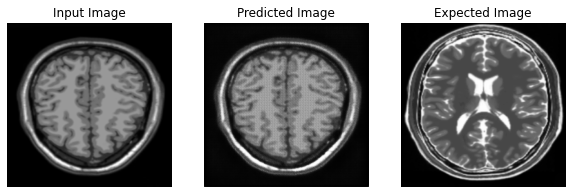

Saving checkpoint for epoch 105 at ./Trained_model/ckpt-106


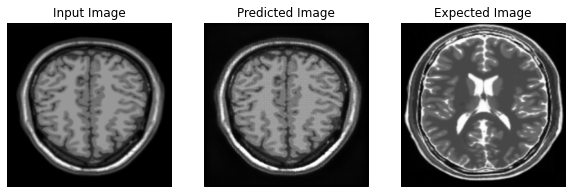

Saving checkpoint for epoch 106 at ./Trained_model/ckpt-107


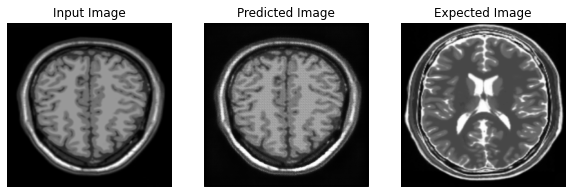

Saving checkpoint for epoch 107 at ./Trained_model/ckpt-108


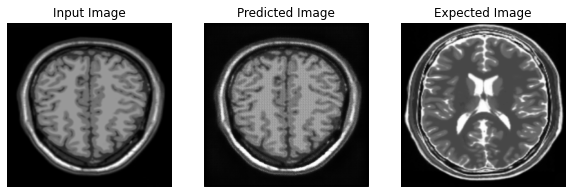

Saving checkpoint for epoch 108 at ./Trained_model/ckpt-109


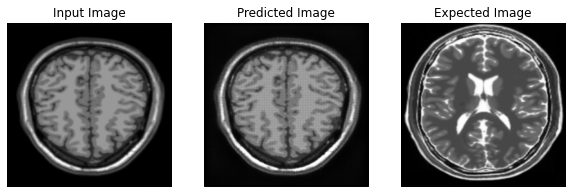

Saving checkpoint for epoch 109 at ./Trained_model/ckpt-110


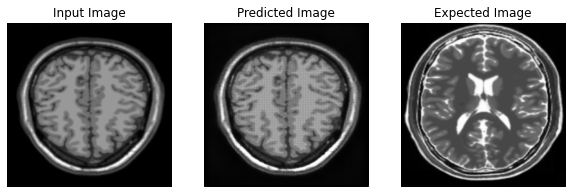

Saving checkpoint for epoch 110 at ./Trained_model/ckpt-111


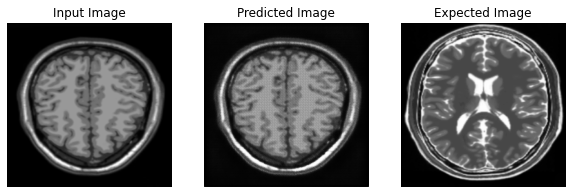

Saving checkpoint for epoch 111 at ./Trained_model/ckpt-112


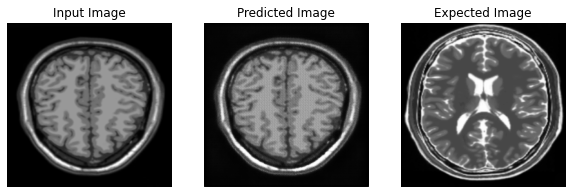

Saving checkpoint for epoch 112 at ./Trained_model/ckpt-113


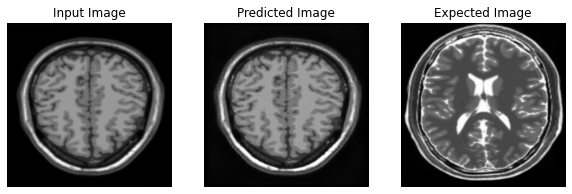

Saving checkpoint for epoch 113 at ./Trained_model/ckpt-114


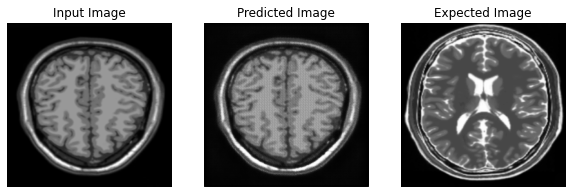

Saving checkpoint for epoch 114 at ./Trained_model/ckpt-115


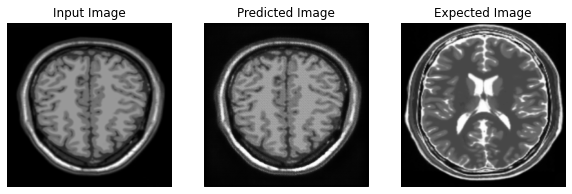

Saving checkpoint for epoch 115 at ./Trained_model/ckpt-116


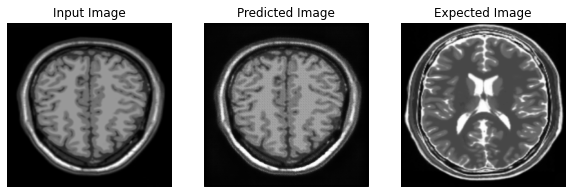

Saving checkpoint for epoch 116 at ./Trained_model/ckpt-117


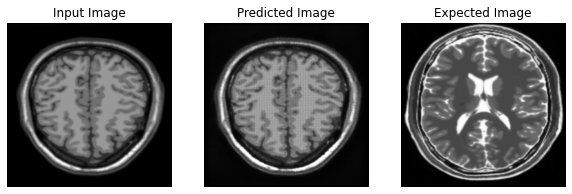

Saving checkpoint for epoch 117 at ./Trained_model/ckpt-118


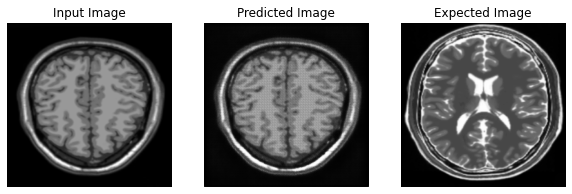

Saving checkpoint for epoch 118 at ./Trained_model/ckpt-119


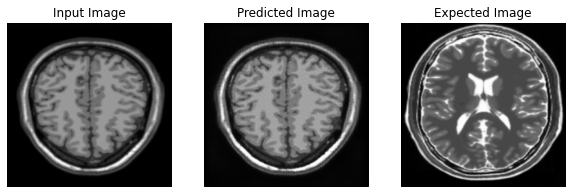

Saving checkpoint for epoch 119 at ./Trained_model/ckpt-120


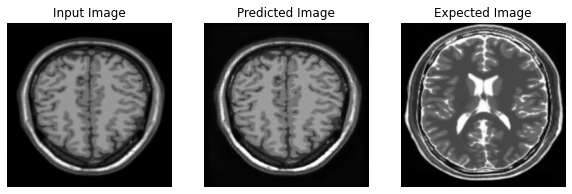

Saving checkpoint for epoch 120 at ./Trained_model/ckpt-121


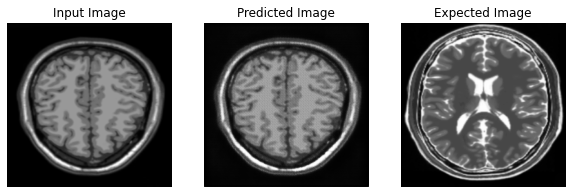

Saving checkpoint for epoch 121 at ./Trained_model/ckpt-122


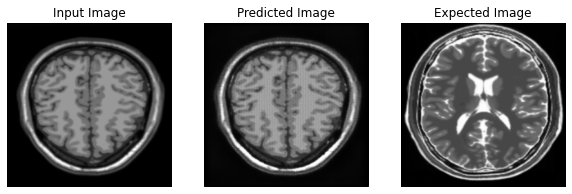

Saving checkpoint for epoch 122 at ./Trained_model/ckpt-123


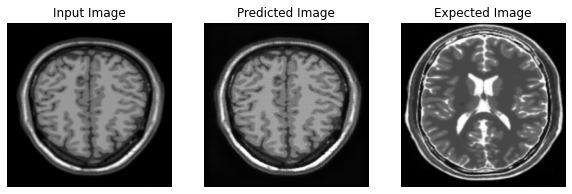

Saving checkpoint for epoch 123 at ./Trained_model/ckpt-124


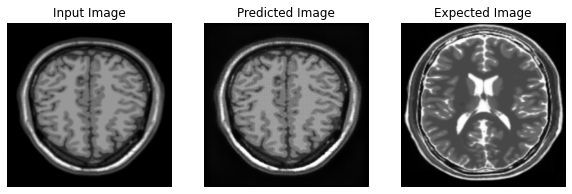

Saving checkpoint for epoch 124 at ./Trained_model/ckpt-125


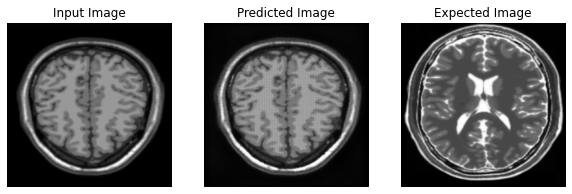

Saving checkpoint for epoch 125 at ./Trained_model/ckpt-126


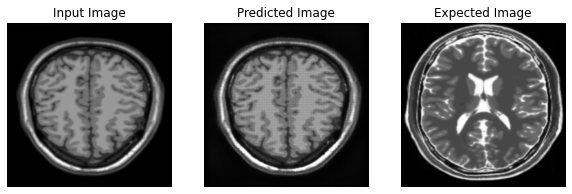

Saving checkpoint for epoch 126 at ./Trained_model/ckpt-127


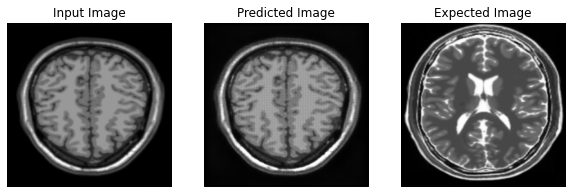

Saving checkpoint for epoch 127 at ./Trained_model/ckpt-128


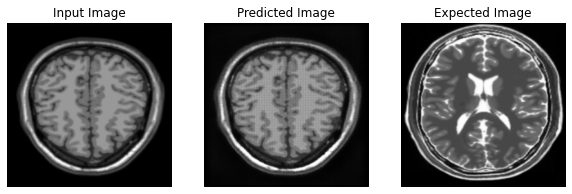

Saving checkpoint for epoch 128 at ./Trained_model/ckpt-129


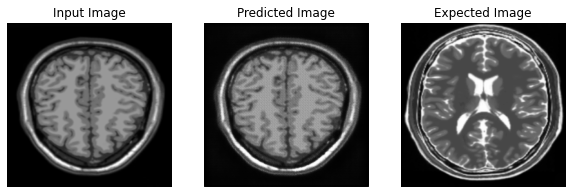

Saving checkpoint for epoch 129 at ./Trained_model/ckpt-130


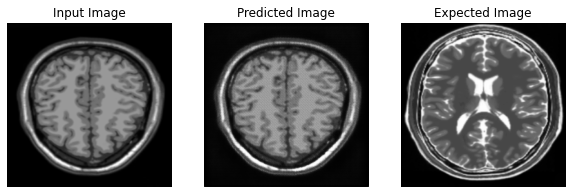

Saving checkpoint for epoch 130 at ./Trained_model/ckpt-131


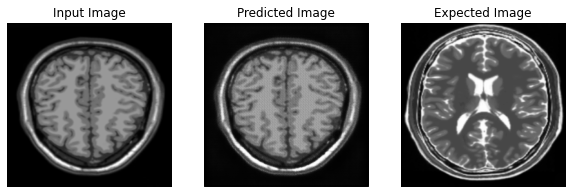

Saving checkpoint for epoch 131 at ./Trained_model/ckpt-132


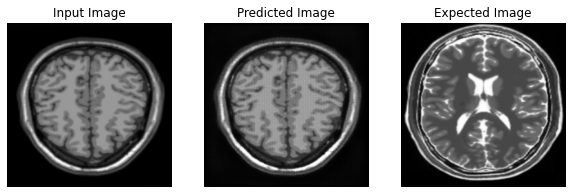

Saving checkpoint for epoch 132 at ./Trained_model/ckpt-133


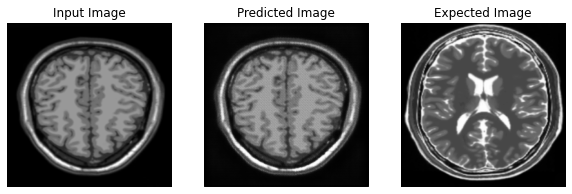

Saving checkpoint for epoch 133 at ./Trained_model/ckpt-134


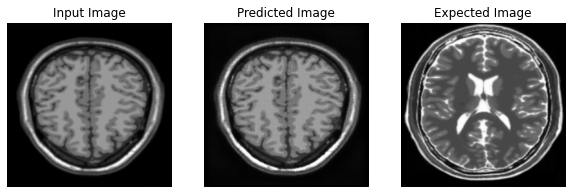

Saving checkpoint for epoch 134 at ./Trained_model/ckpt-135


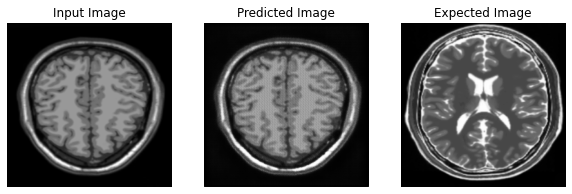

Saving checkpoint for epoch 135 at ./Trained_model/ckpt-136


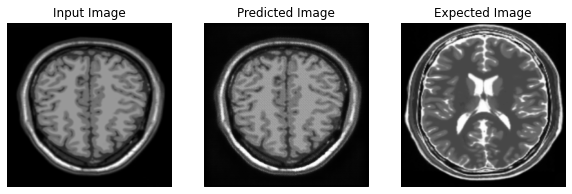

Saving checkpoint for epoch 136 at ./Trained_model/ckpt-137


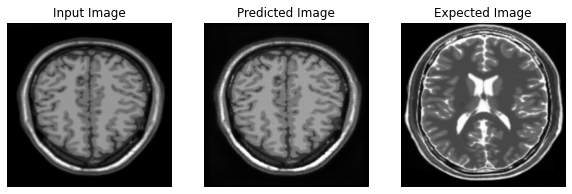

Saving checkpoint for epoch 137 at ./Trained_model/ckpt-138


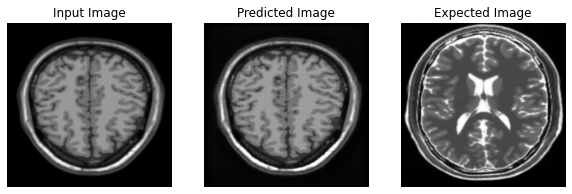

Saving checkpoint for epoch 138 at ./Trained_model/ckpt-139


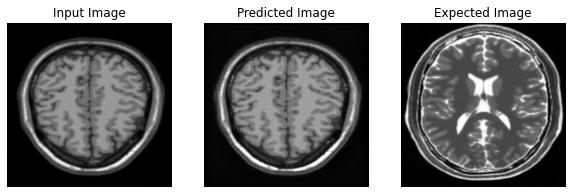

Saving checkpoint for epoch 139 at ./Trained_model/ckpt-140


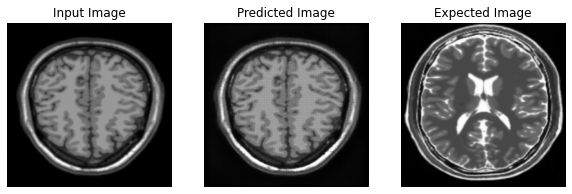

Saving checkpoint for epoch 140 at ./Trained_model/ckpt-141


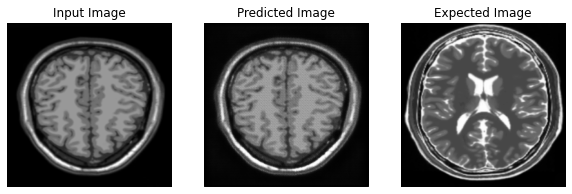

Saving checkpoint for epoch 141 at ./Trained_model/ckpt-142


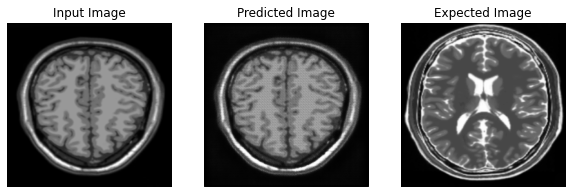

Saving checkpoint for epoch 142 at ./Trained_model/ckpt-143


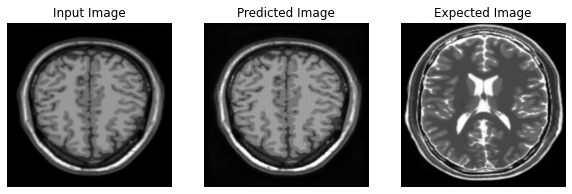

Saving checkpoint for epoch 143 at ./Trained_model/ckpt-144


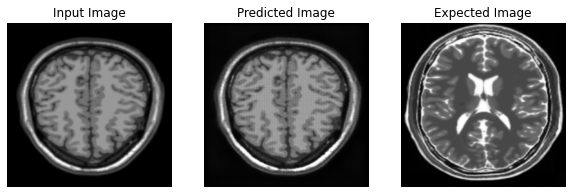

Saving checkpoint for epoch 144 at ./Trained_model/ckpt-145


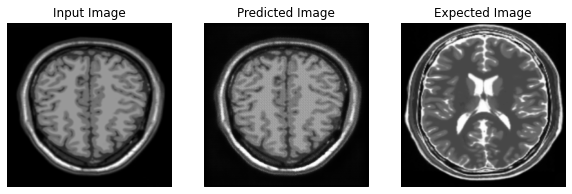

Saving checkpoint for epoch 145 at ./Trained_model/ckpt-146


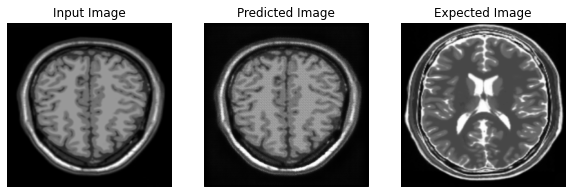

Saving checkpoint for epoch 146 at ./Trained_model/ckpt-147


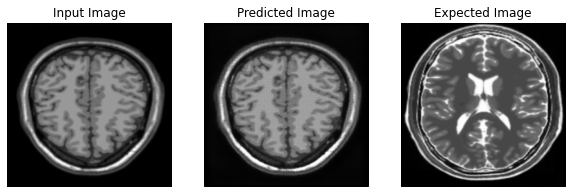

Saving checkpoint for epoch 147 at ./Trained_model/ckpt-148


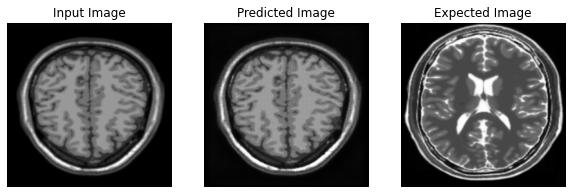

Saving checkpoint for epoch 148 at ./Trained_model/ckpt-149


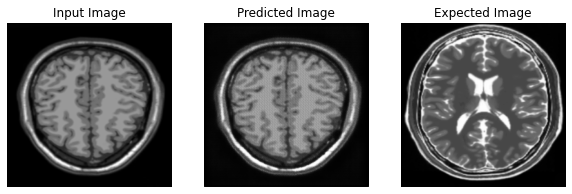

Saving checkpoint for epoch 149 at ./Trained_model/ckpt-150


In [36]:
for epoch in range(EPOCHS):
    for image_x, image_y in tf.data.Dataset.zip((tr1_dat, tr2_dat)):
        train_step(image_x, image_y)
    generate_images(generator_g, sample_tr1, sample_tr2)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

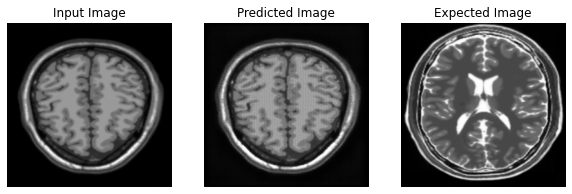

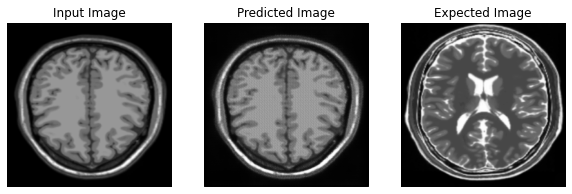

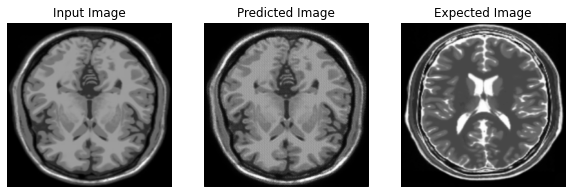

In [37]:
# Runing the trained model on the test dataset
for inp in tr1_dat.take(5):
    generate_images(generator_g, inp, sample_tr2)

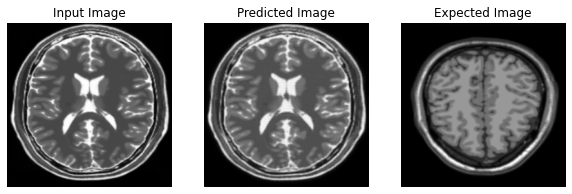

Saving checkpoint for epoch 0 at ./Trained_model/ckpt-151


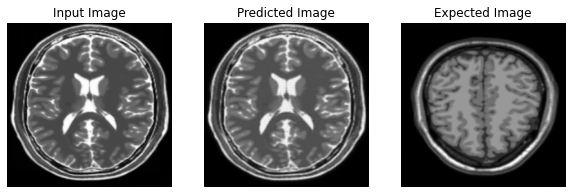

Saving checkpoint for epoch 1 at ./Trained_model/ckpt-152


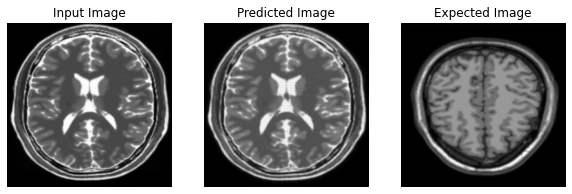

Saving checkpoint for epoch 2 at ./Trained_model/ckpt-153


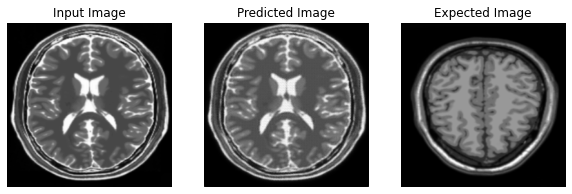

Saving checkpoint for epoch 3 at ./Trained_model/ckpt-154


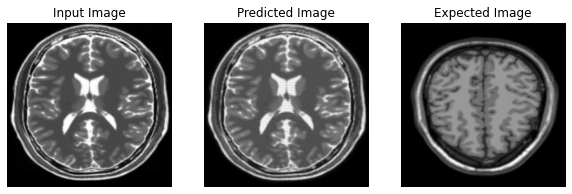

Saving checkpoint for epoch 4 at ./Trained_model/ckpt-155


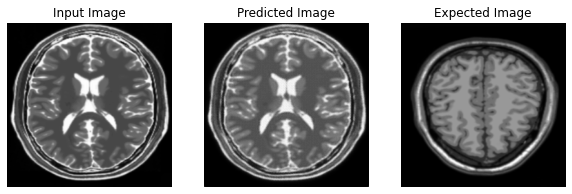

Saving checkpoint for epoch 5 at ./Trained_model/ckpt-156


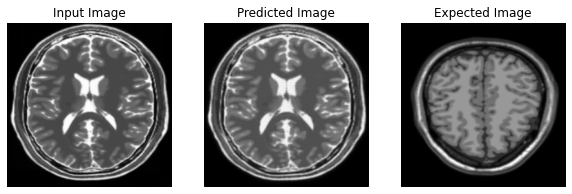

Saving checkpoint for epoch 6 at ./Trained_model/ckpt-157


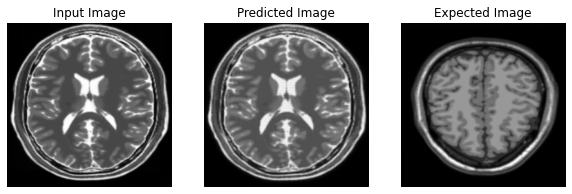

Saving checkpoint for epoch 7 at ./Trained_model/ckpt-158


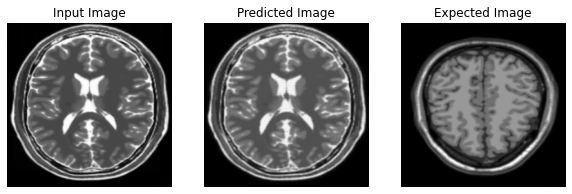

Saving checkpoint for epoch 8 at ./Trained_model/ckpt-159


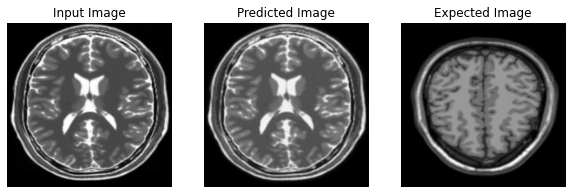

Saving checkpoint for epoch 9 at ./Trained_model/ckpt-160


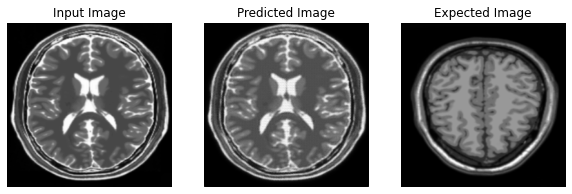

Saving checkpoint for epoch 10 at ./Trained_model/ckpt-161


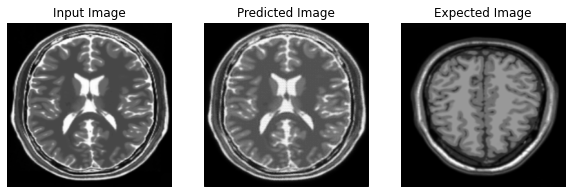

Saving checkpoint for epoch 11 at ./Trained_model/ckpt-162


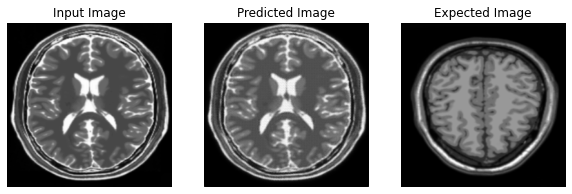

Saving checkpoint for epoch 12 at ./Trained_model/ckpt-163


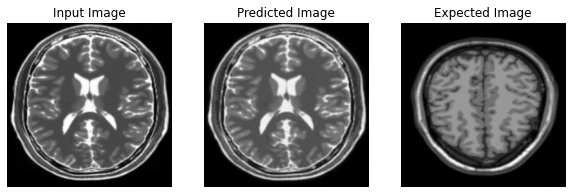

Saving checkpoint for epoch 13 at ./Trained_model/ckpt-164


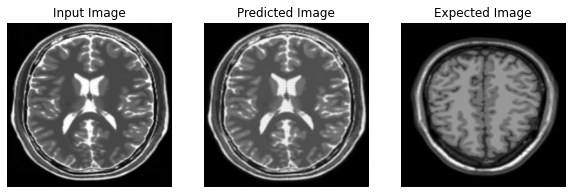

Saving checkpoint for epoch 14 at ./Trained_model/ckpt-165


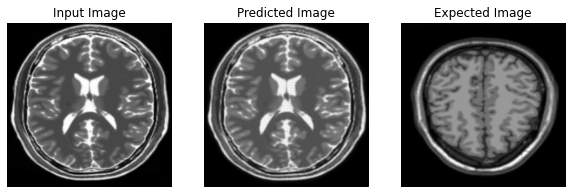

Saving checkpoint for epoch 15 at ./Trained_model/ckpt-166


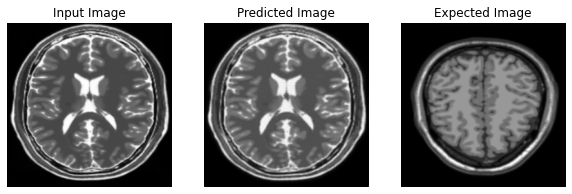

Saving checkpoint for epoch 16 at ./Trained_model/ckpt-167


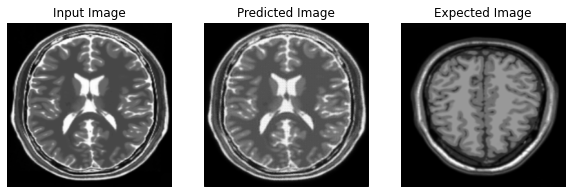

Saving checkpoint for epoch 17 at ./Trained_model/ckpt-168


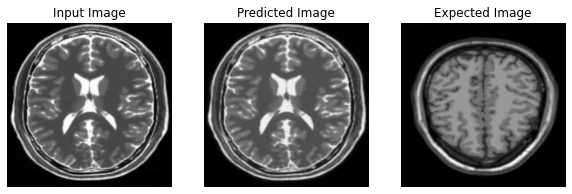

Saving checkpoint for epoch 18 at ./Trained_model/ckpt-169


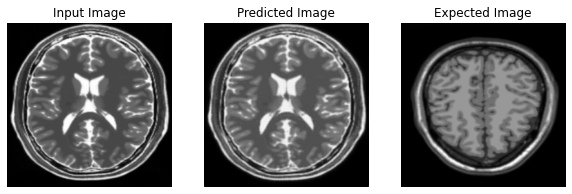

Saving checkpoint for epoch 19 at ./Trained_model/ckpt-170


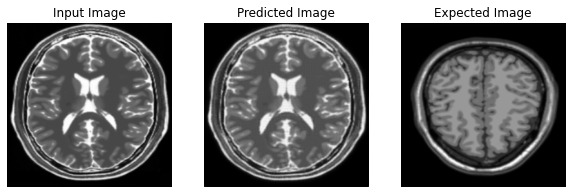

Saving checkpoint for epoch 20 at ./Trained_model/ckpt-171


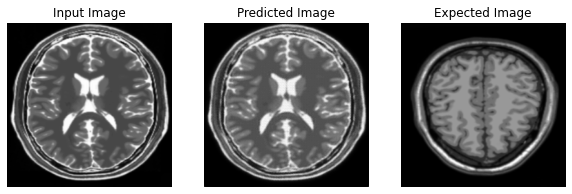

Saving checkpoint for epoch 21 at ./Trained_model/ckpt-172


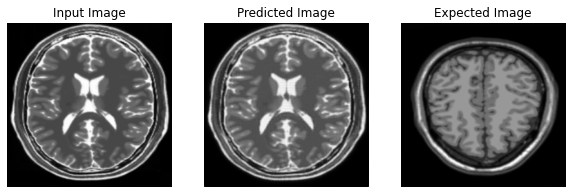

Saving checkpoint for epoch 22 at ./Trained_model/ckpt-173


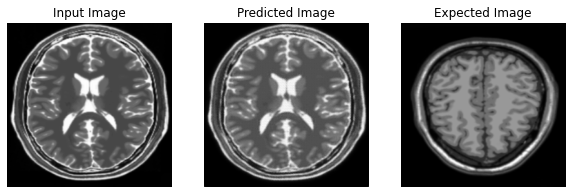

Saving checkpoint for epoch 23 at ./Trained_model/ckpt-174


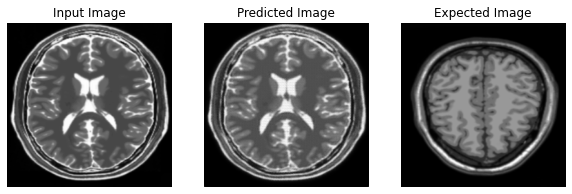

Saving checkpoint for epoch 24 at ./Trained_model/ckpt-175


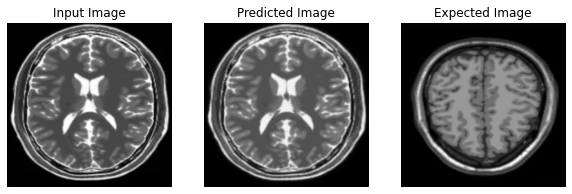

Saving checkpoint for epoch 25 at ./Trained_model/ckpt-176


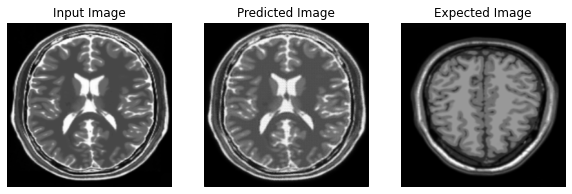

Saving checkpoint for epoch 26 at ./Trained_model/ckpt-177


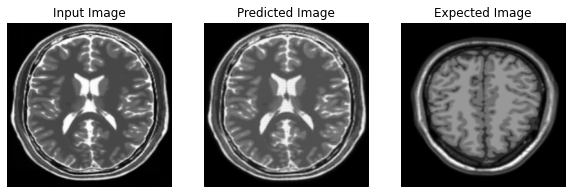

Saving checkpoint for epoch 27 at ./Trained_model/ckpt-178


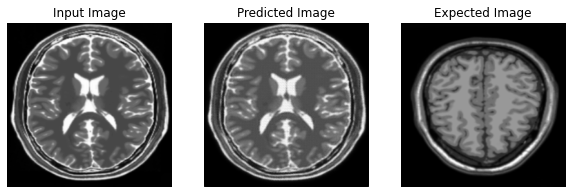

Saving checkpoint for epoch 28 at ./Trained_model/ckpt-179


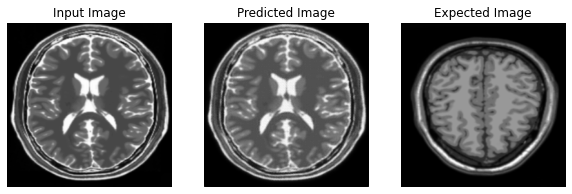

Saving checkpoint for epoch 29 at ./Trained_model/ckpt-180


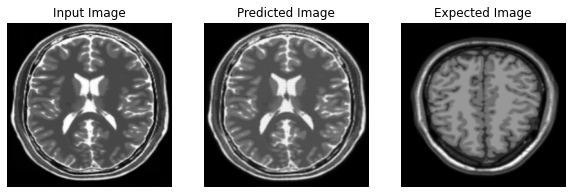

Saving checkpoint for epoch 30 at ./Trained_model/ckpt-181


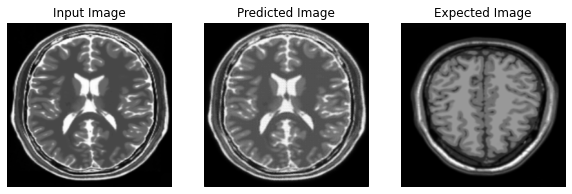

Saving checkpoint for epoch 31 at ./Trained_model/ckpt-182


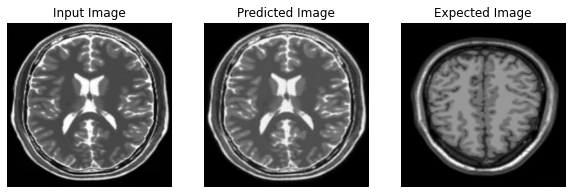

Saving checkpoint for epoch 32 at ./Trained_model/ckpt-183


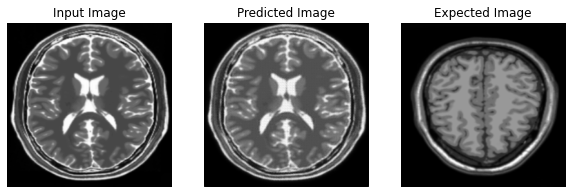

Saving checkpoint for epoch 33 at ./Trained_model/ckpt-184


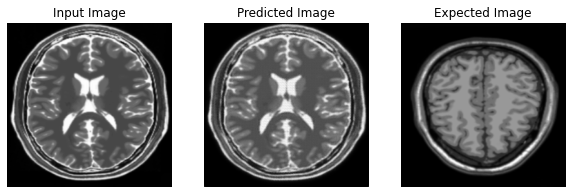

Saving checkpoint for epoch 34 at ./Trained_model/ckpt-185


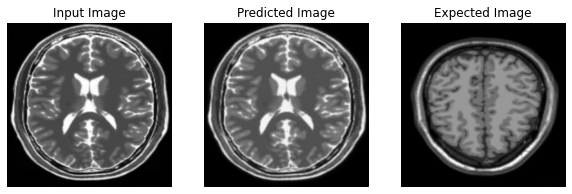

Saving checkpoint for epoch 35 at ./Trained_model/ckpt-186


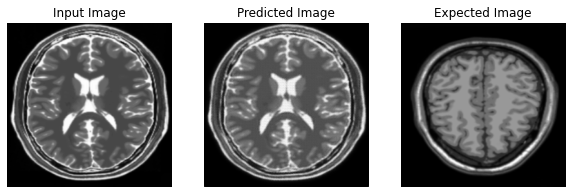

Saving checkpoint for epoch 36 at ./Trained_model/ckpt-187


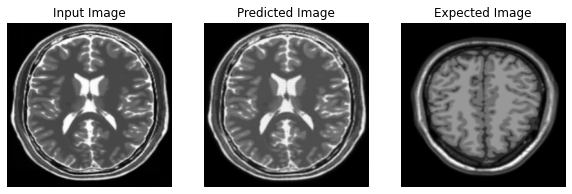

Saving checkpoint for epoch 37 at ./Trained_model/ckpt-188


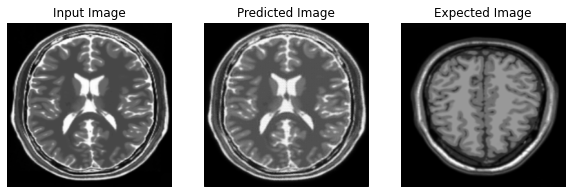

Saving checkpoint for epoch 38 at ./Trained_model/ckpt-189


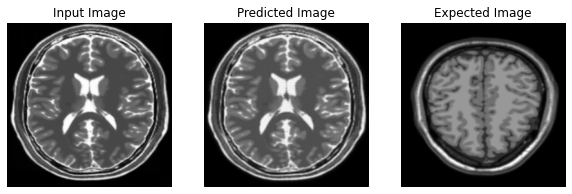

Saving checkpoint for epoch 39 at ./Trained_model/ckpt-190


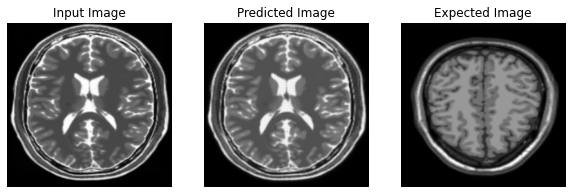

Saving checkpoint for epoch 40 at ./Trained_model/ckpt-191


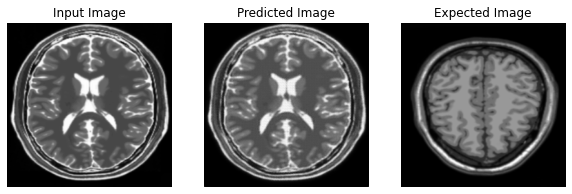

Saving checkpoint for epoch 41 at ./Trained_model/ckpt-192


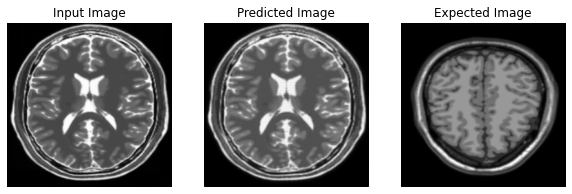

Saving checkpoint for epoch 42 at ./Trained_model/ckpt-193


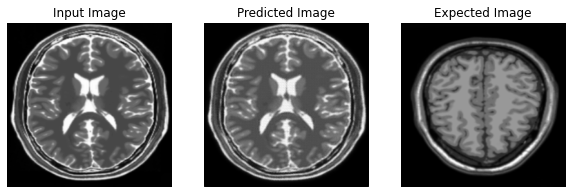

Saving checkpoint for epoch 43 at ./Trained_model/ckpt-194


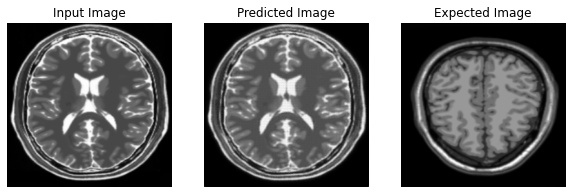

Saving checkpoint for epoch 44 at ./Trained_model/ckpt-195


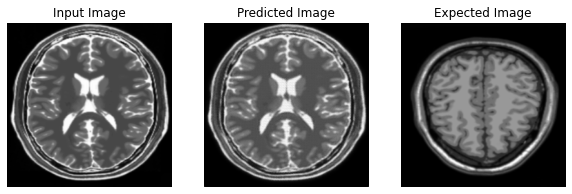

Saving checkpoint for epoch 45 at ./Trained_model/ckpt-196


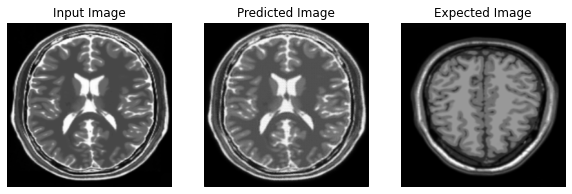

Saving checkpoint for epoch 46 at ./Trained_model/ckpt-197


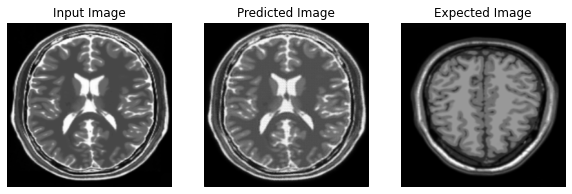

Saving checkpoint for epoch 47 at ./Trained_model/ckpt-198


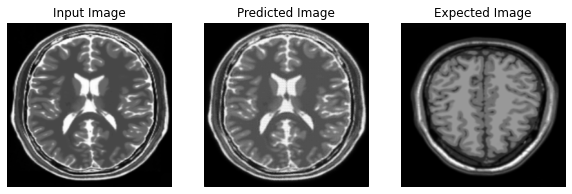

Saving checkpoint for epoch 48 at ./Trained_model/ckpt-199


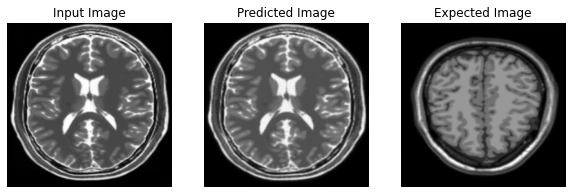

Saving checkpoint for epoch 49 at ./Trained_model/ckpt-200


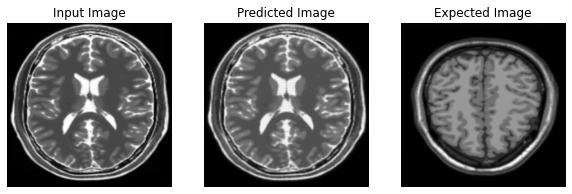

Saving checkpoint for epoch 50 at ./Trained_model/ckpt-201


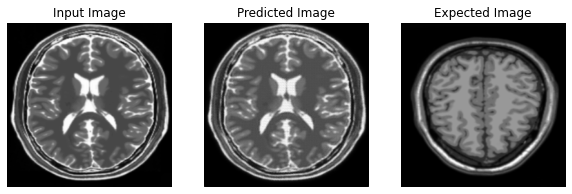

Saving checkpoint for epoch 51 at ./Trained_model/ckpt-202


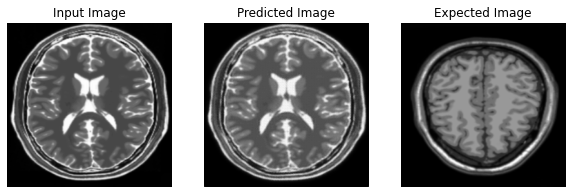

Saving checkpoint for epoch 52 at ./Trained_model/ckpt-203


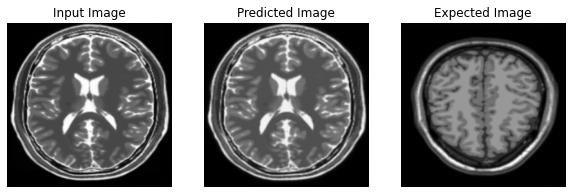

Saving checkpoint for epoch 53 at ./Trained_model/ckpt-204


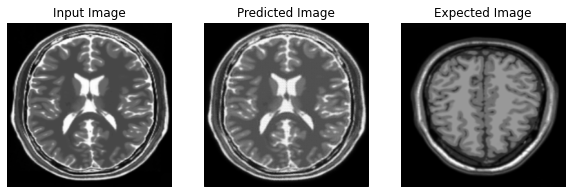

Saving checkpoint for epoch 54 at ./Trained_model/ckpt-205


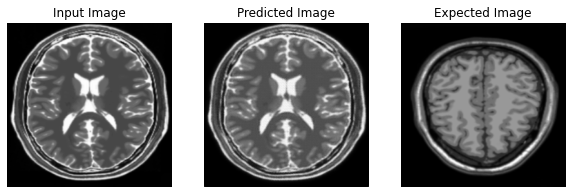

Saving checkpoint for epoch 55 at ./Trained_model/ckpt-206


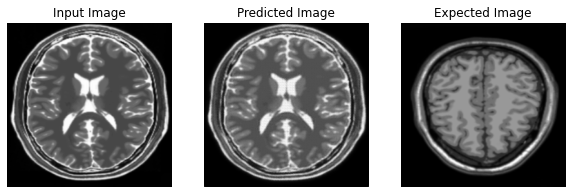

Saving checkpoint for epoch 56 at ./Trained_model/ckpt-207


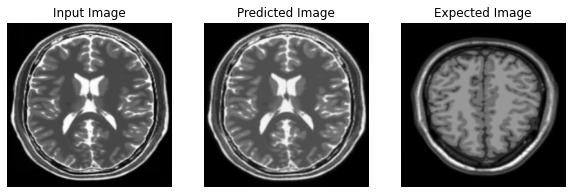

Saving checkpoint for epoch 57 at ./Trained_model/ckpt-208


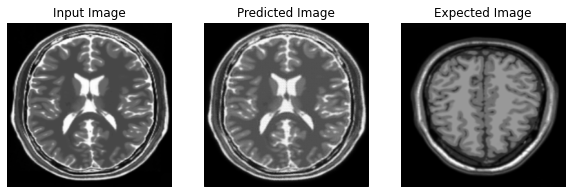

Saving checkpoint for epoch 58 at ./Trained_model/ckpt-209


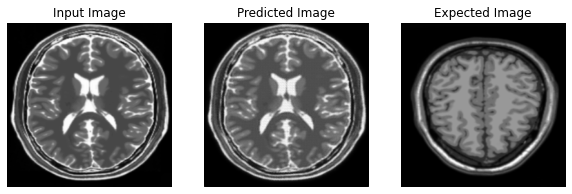

Saving checkpoint for epoch 59 at ./Trained_model/ckpt-210


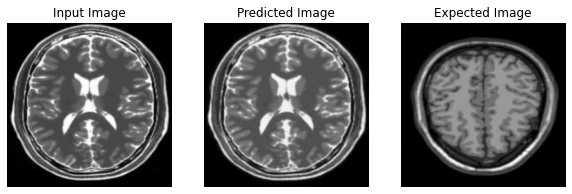

Saving checkpoint for epoch 60 at ./Trained_model/ckpt-211


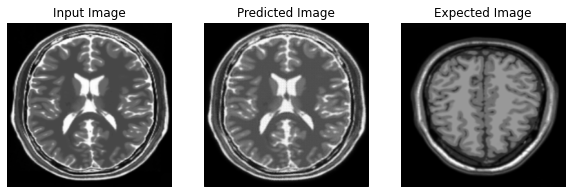

Saving checkpoint for epoch 61 at ./Trained_model/ckpt-212


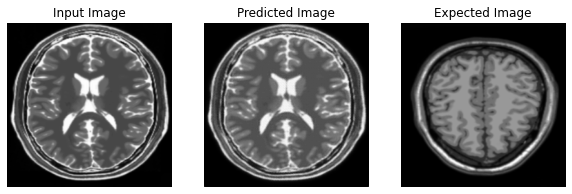

Saving checkpoint for epoch 62 at ./Trained_model/ckpt-213


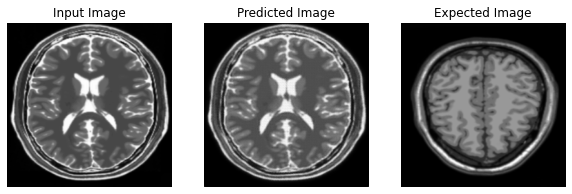

Saving checkpoint for epoch 63 at ./Trained_model/ckpt-214


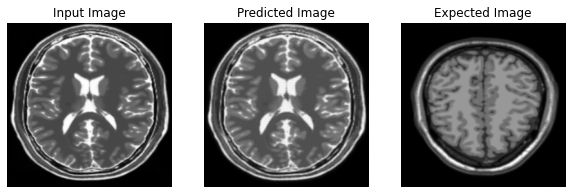

Saving checkpoint for epoch 64 at ./Trained_model/ckpt-215


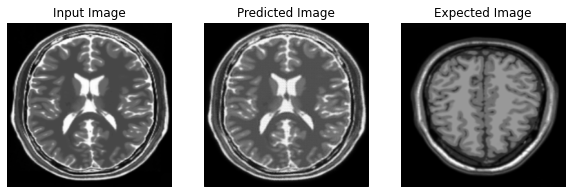

Saving checkpoint for epoch 65 at ./Trained_model/ckpt-216


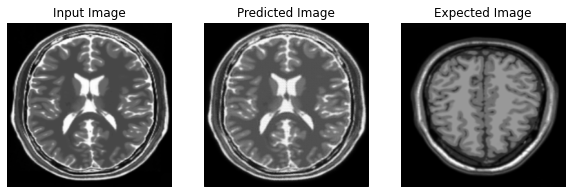

Saving checkpoint for epoch 66 at ./Trained_model/ckpt-217


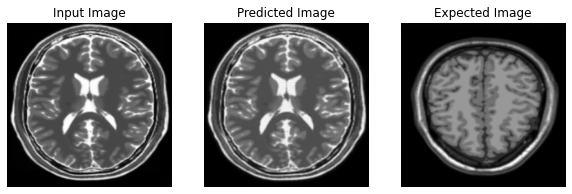

Saving checkpoint for epoch 67 at ./Trained_model/ckpt-218


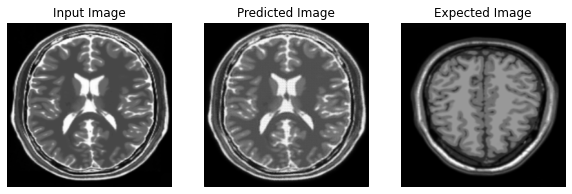

Saving checkpoint for epoch 68 at ./Trained_model/ckpt-219


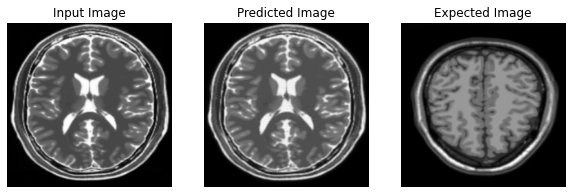

Saving checkpoint for epoch 69 at ./Trained_model/ckpt-220


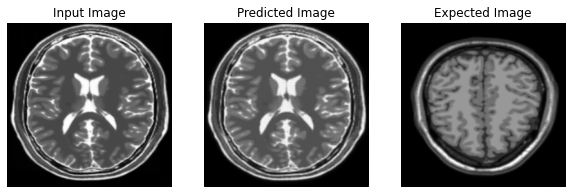

Saving checkpoint for epoch 70 at ./Trained_model/ckpt-221


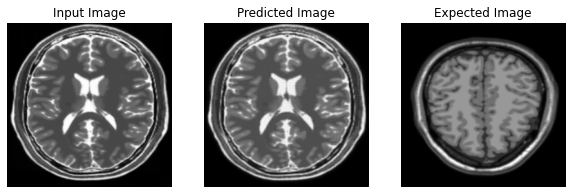

Saving checkpoint for epoch 71 at ./Trained_model/ckpt-222


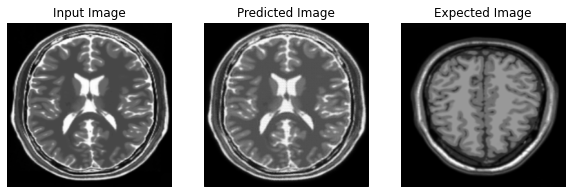

Saving checkpoint for epoch 72 at ./Trained_model/ckpt-223


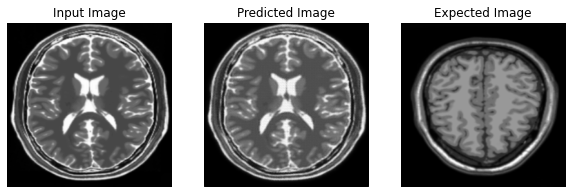

Saving checkpoint for epoch 73 at ./Trained_model/ckpt-224


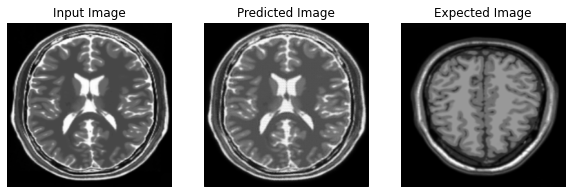

Saving checkpoint for epoch 74 at ./Trained_model/ckpt-225


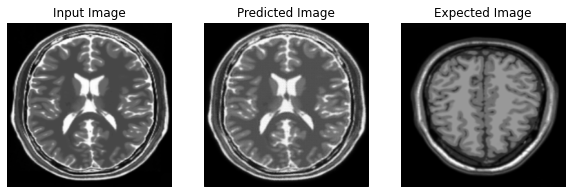

Saving checkpoint for epoch 75 at ./Trained_model/ckpt-226


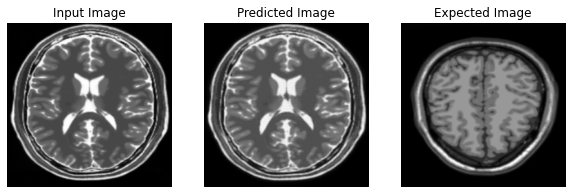

Saving checkpoint for epoch 76 at ./Trained_model/ckpt-227


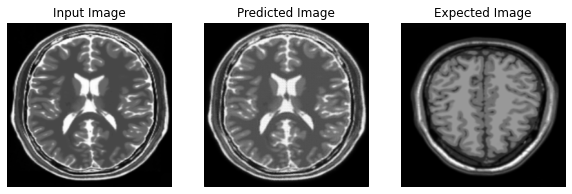

Saving checkpoint for epoch 77 at ./Trained_model/ckpt-228


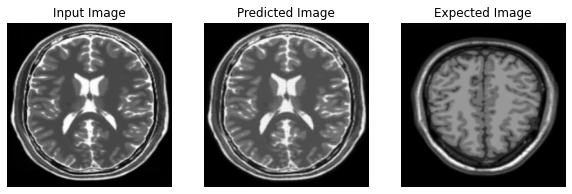

Saving checkpoint for epoch 78 at ./Trained_model/ckpt-229


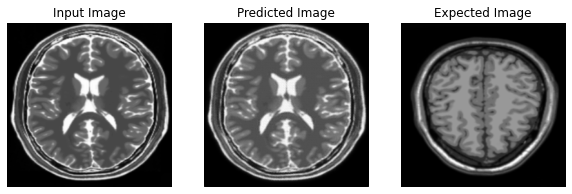

Saving checkpoint for epoch 79 at ./Trained_model/ckpt-230


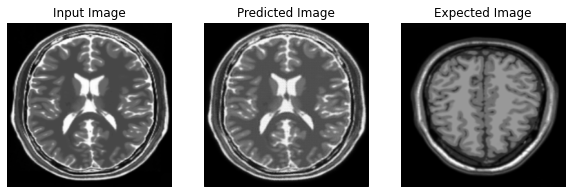

Saving checkpoint for epoch 80 at ./Trained_model/ckpt-231


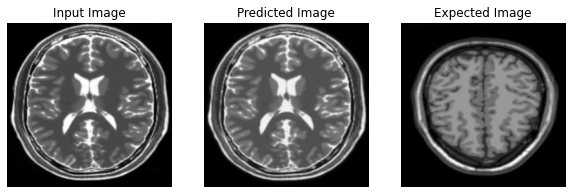

Saving checkpoint for epoch 81 at ./Trained_model/ckpt-232


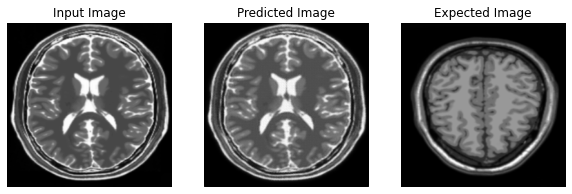

Saving checkpoint for epoch 82 at ./Trained_model/ckpt-233


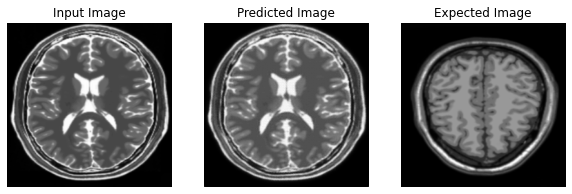

Saving checkpoint for epoch 83 at ./Trained_model/ckpt-234


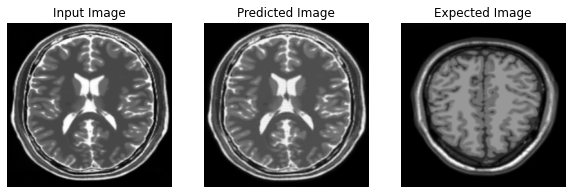

Saving checkpoint for epoch 84 at ./Trained_model/ckpt-235


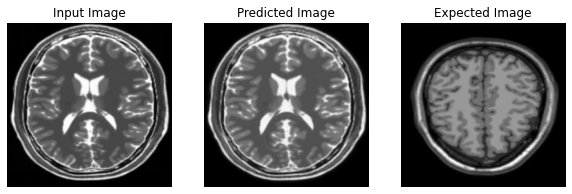

Saving checkpoint for epoch 85 at ./Trained_model/ckpt-236


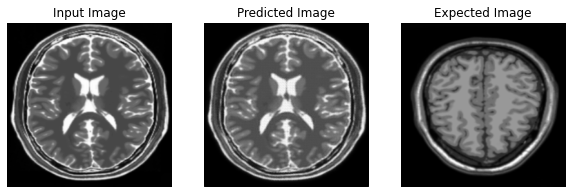

Saving checkpoint for epoch 86 at ./Trained_model/ckpt-237


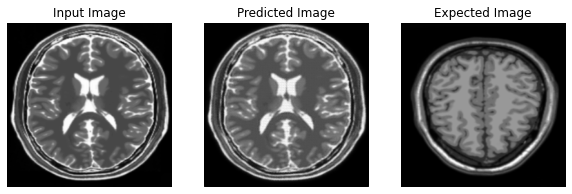

Saving checkpoint for epoch 87 at ./Trained_model/ckpt-238


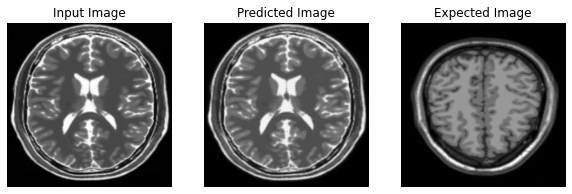

Saving checkpoint for epoch 88 at ./Trained_model/ckpt-239


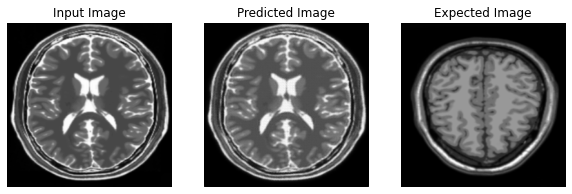

Saving checkpoint for epoch 89 at ./Trained_model/ckpt-240


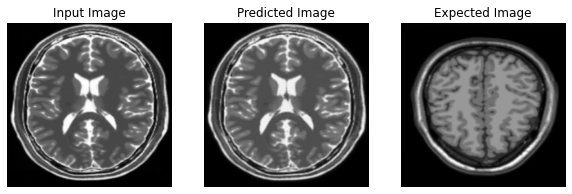

Saving checkpoint for epoch 90 at ./Trained_model/ckpt-241


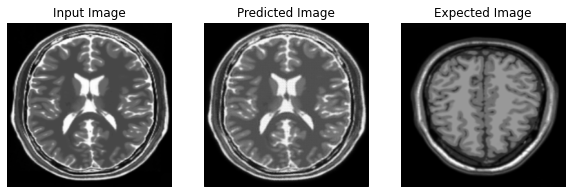

Saving checkpoint for epoch 91 at ./Trained_model/ckpt-242


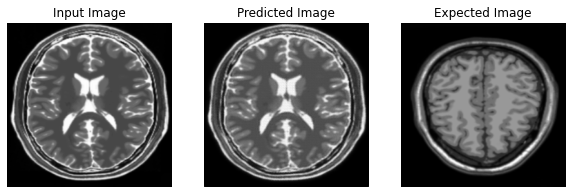

Saving checkpoint for epoch 92 at ./Trained_model/ckpt-243


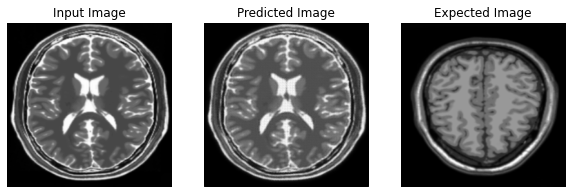

Saving checkpoint for epoch 93 at ./Trained_model/ckpt-244


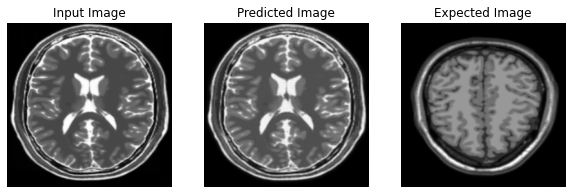

Saving checkpoint for epoch 94 at ./Trained_model/ckpt-245


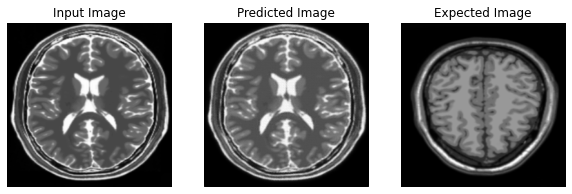

Saving checkpoint for epoch 95 at ./Trained_model/ckpt-246


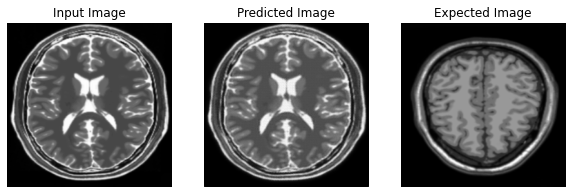

Saving checkpoint for epoch 96 at ./Trained_model/ckpt-247


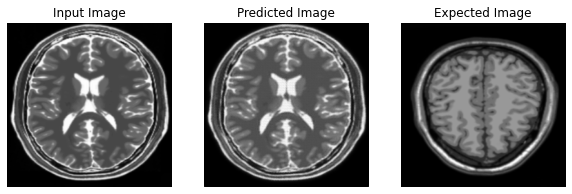

Saving checkpoint for epoch 97 at ./Trained_model/ckpt-248


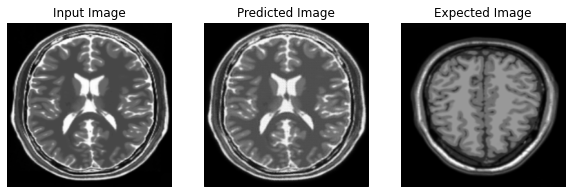

Saving checkpoint for epoch 98 at ./Trained_model/ckpt-249


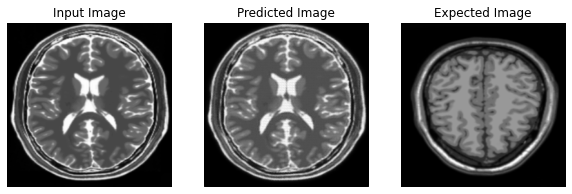

Saving checkpoint for epoch 99 at ./Trained_model/ckpt-250


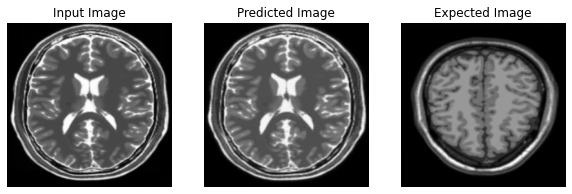

Saving checkpoint for epoch 100 at ./Trained_model/ckpt-251


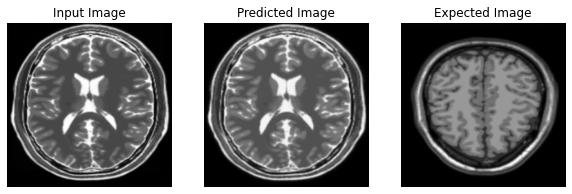

Saving checkpoint for epoch 101 at ./Trained_model/ckpt-252


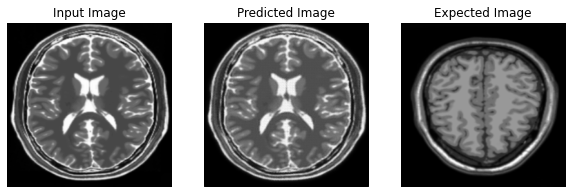

Saving checkpoint for epoch 102 at ./Trained_model/ckpt-253


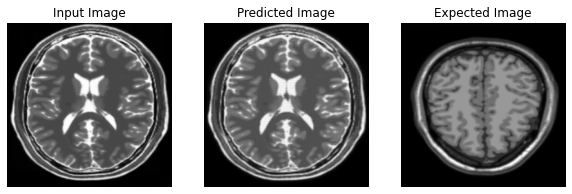

Saving checkpoint for epoch 103 at ./Trained_model/ckpt-254


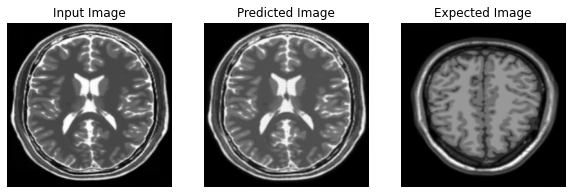

Saving checkpoint for epoch 104 at ./Trained_model/ckpt-255


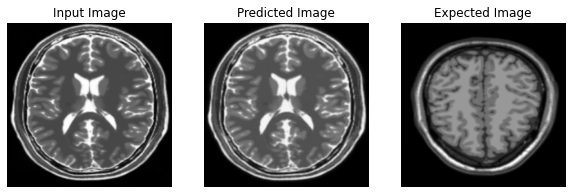

Saving checkpoint for epoch 105 at ./Trained_model/ckpt-256


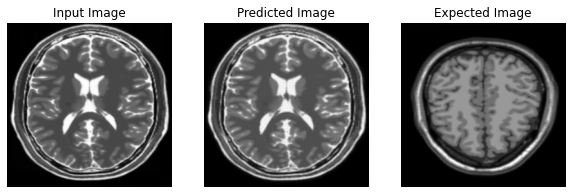

Saving checkpoint for epoch 106 at ./Trained_model/ckpt-257


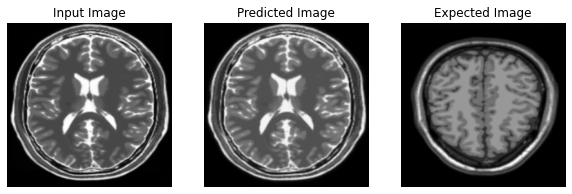

Saving checkpoint for epoch 107 at ./Trained_model/ckpt-258


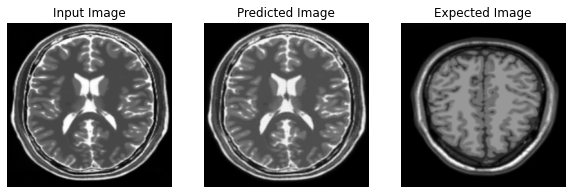

Saving checkpoint for epoch 108 at ./Trained_model/ckpt-259


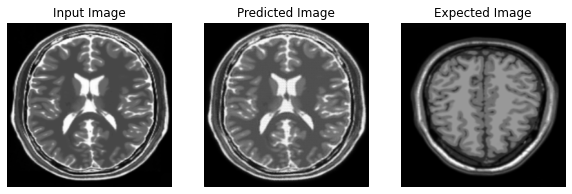

Saving checkpoint for epoch 109 at ./Trained_model/ckpt-260


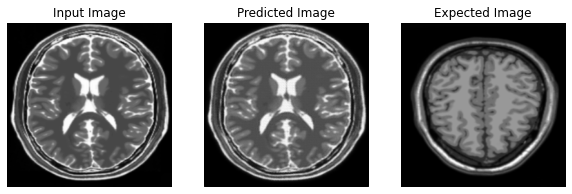

Saving checkpoint for epoch 110 at ./Trained_model/ckpt-261


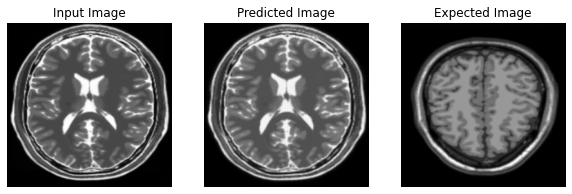

Saving checkpoint for epoch 111 at ./Trained_model/ckpt-262


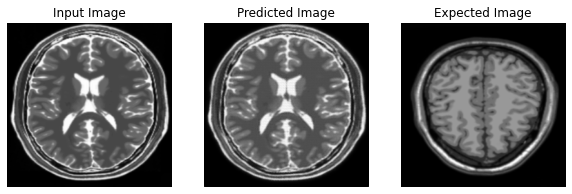

Saving checkpoint for epoch 112 at ./Trained_model/ckpt-263


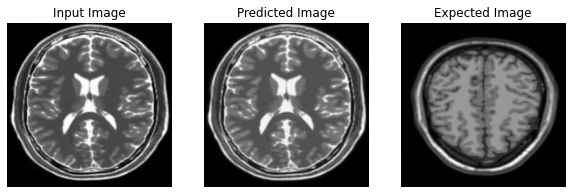

Saving checkpoint for epoch 113 at ./Trained_model/ckpt-264


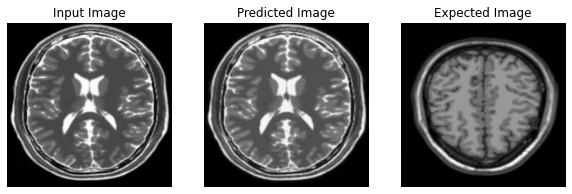

Saving checkpoint for epoch 114 at ./Trained_model/ckpt-265


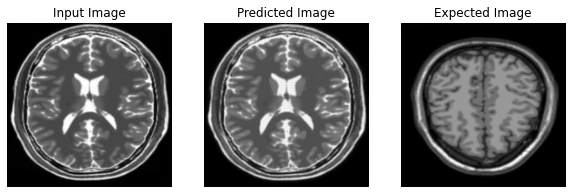

Saving checkpoint for epoch 115 at ./Trained_model/ckpt-266


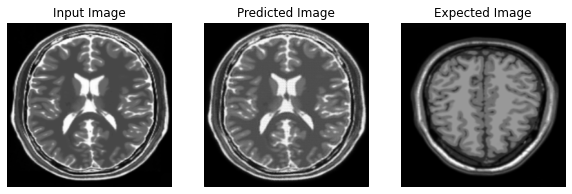

Saving checkpoint for epoch 116 at ./Trained_model/ckpt-267


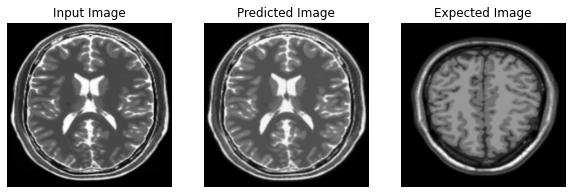

Saving checkpoint for epoch 117 at ./Trained_model/ckpt-268


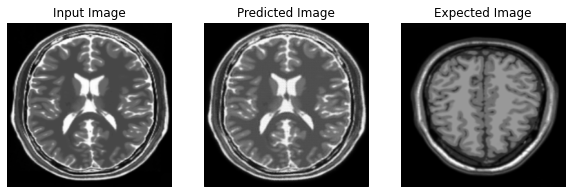

Saving checkpoint for epoch 118 at ./Trained_model/ckpt-269


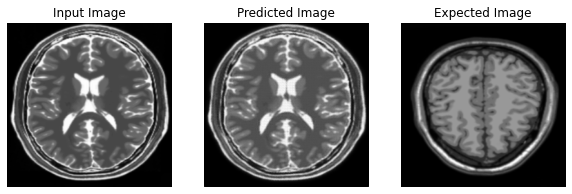

Saving checkpoint for epoch 119 at ./Trained_model/ckpt-270


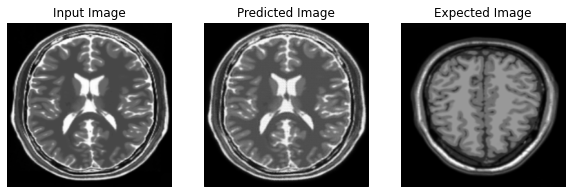

Saving checkpoint for epoch 120 at ./Trained_model/ckpt-271


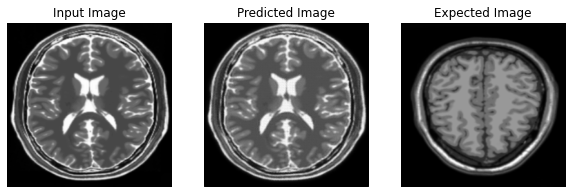

Saving checkpoint for epoch 121 at ./Trained_model/ckpt-272


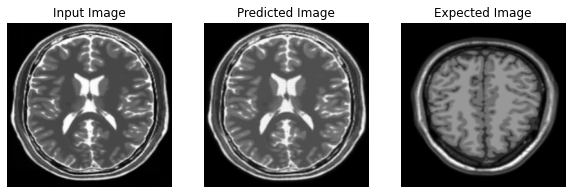

Saving checkpoint for epoch 122 at ./Trained_model/ckpt-273


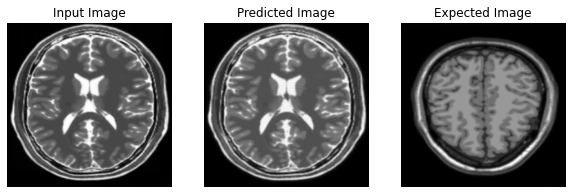

Saving checkpoint for epoch 123 at ./Trained_model/ckpt-274


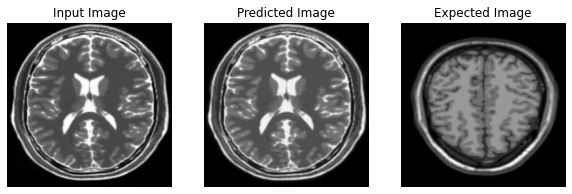

Saving checkpoint for epoch 124 at ./Trained_model/ckpt-275


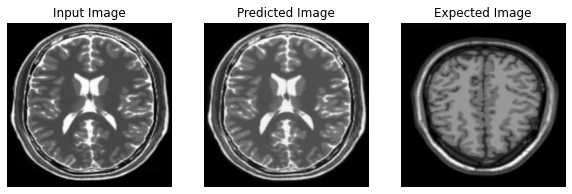

Saving checkpoint for epoch 125 at ./Trained_model/ckpt-276


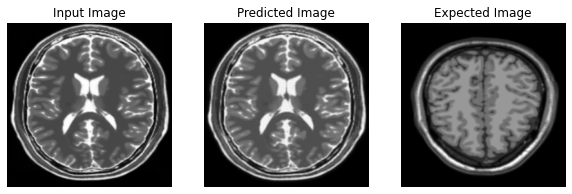

Saving checkpoint for epoch 126 at ./Trained_model/ckpt-277


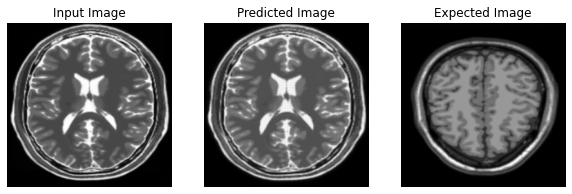

Saving checkpoint for epoch 127 at ./Trained_model/ckpt-278


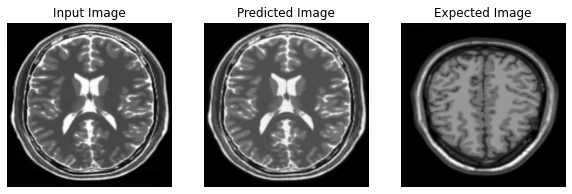

Saving checkpoint for epoch 128 at ./Trained_model/ckpt-279


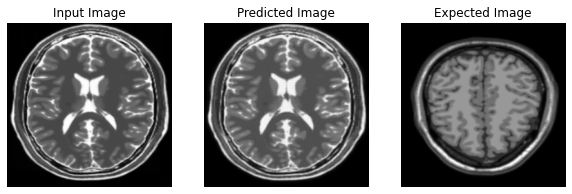

Saving checkpoint for epoch 129 at ./Trained_model/ckpt-280


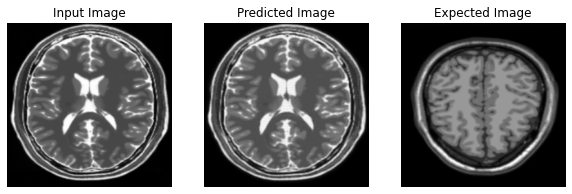

Saving checkpoint for epoch 130 at ./Trained_model/ckpt-281


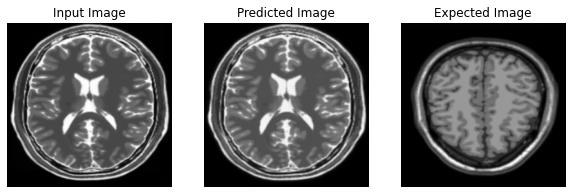

Saving checkpoint for epoch 131 at ./Trained_model/ckpt-282


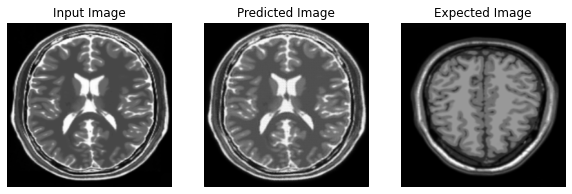

Saving checkpoint for epoch 132 at ./Trained_model/ckpt-283


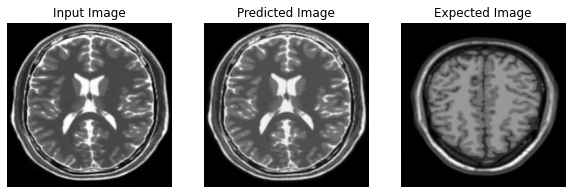

Saving checkpoint for epoch 133 at ./Trained_model/ckpt-284


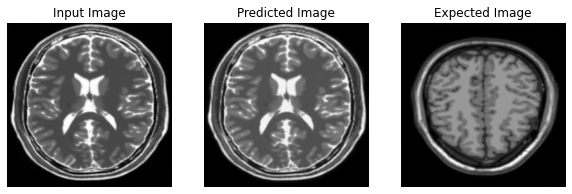

Saving checkpoint for epoch 134 at ./Trained_model/ckpt-285


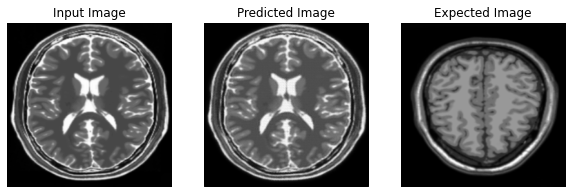

Saving checkpoint for epoch 135 at ./Trained_model/ckpt-286


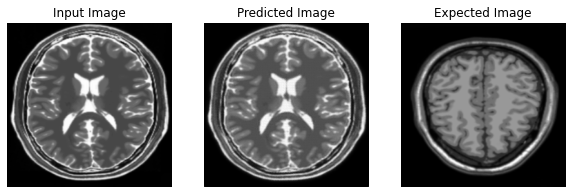

Saving checkpoint for epoch 136 at ./Trained_model/ckpt-287


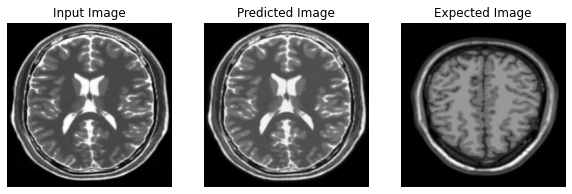

Saving checkpoint for epoch 137 at ./Trained_model/ckpt-288


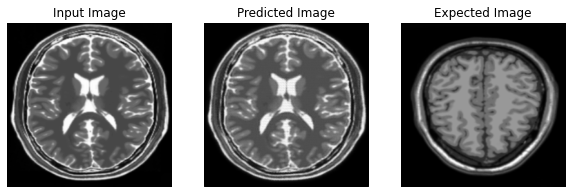

Saving checkpoint for epoch 138 at ./Trained_model/ckpt-289


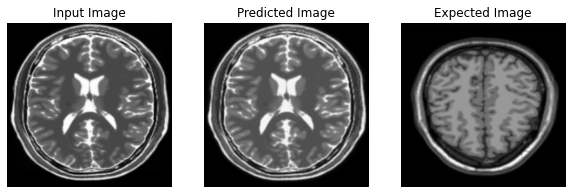

Saving checkpoint for epoch 139 at ./Trained_model/ckpt-290


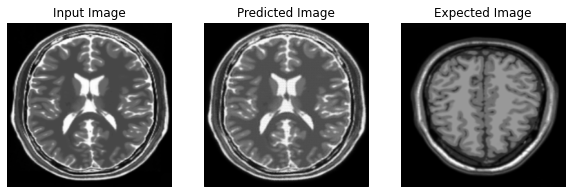

Saving checkpoint for epoch 140 at ./Trained_model/ckpt-291


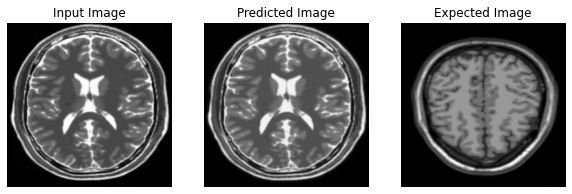

Saving checkpoint for epoch 141 at ./Trained_model/ckpt-292


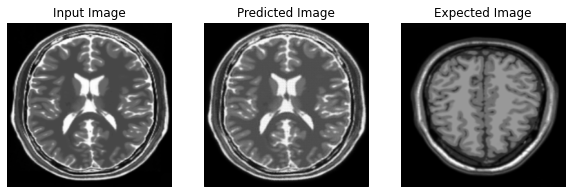

Saving checkpoint for epoch 142 at ./Trained_model/ckpt-293


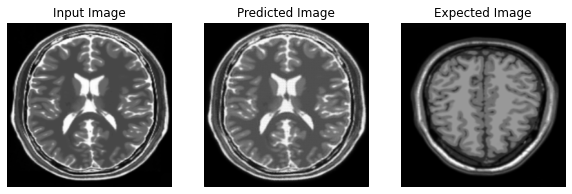

Saving checkpoint for epoch 143 at ./Trained_model/ckpt-294


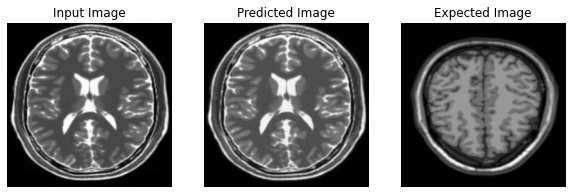

Saving checkpoint for epoch 144 at ./Trained_model/ckpt-295


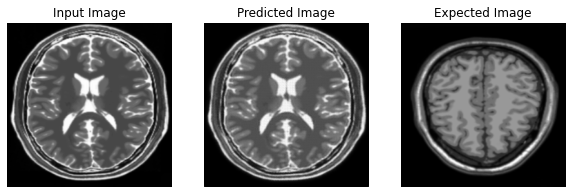

Saving checkpoint for epoch 145 at ./Trained_model/ckpt-296


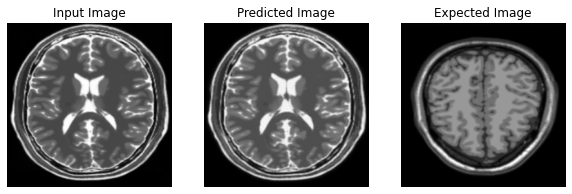

Saving checkpoint for epoch 146 at ./Trained_model/ckpt-297


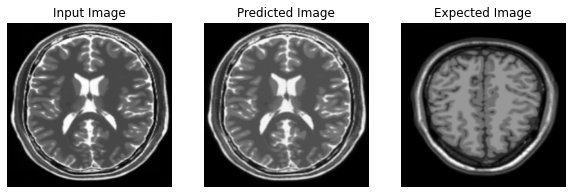

Saving checkpoint for epoch 147 at ./Trained_model/ckpt-298


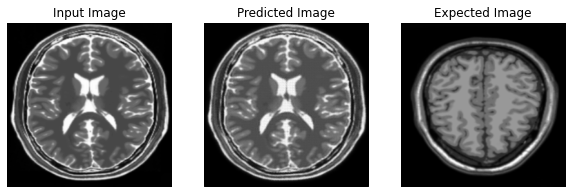

Saving checkpoint for epoch 148 at ./Trained_model/ckpt-299


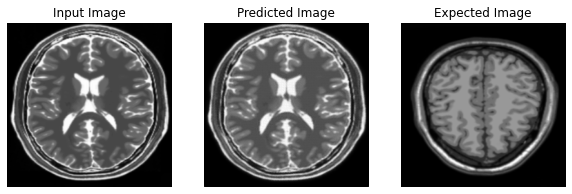

Saving checkpoint for epoch 149 at ./Trained_model/ckpt-300


In [39]:
for epoch in range(EPOCHS):
    for image_x, image_y in tf.data.Dataset.zip((tr1_dat, tr2_dat)):
        train_step(image_x, image_y)
    generate_images(generator_f, sample_tr2, sample_tr1)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

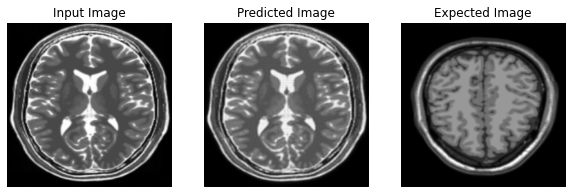

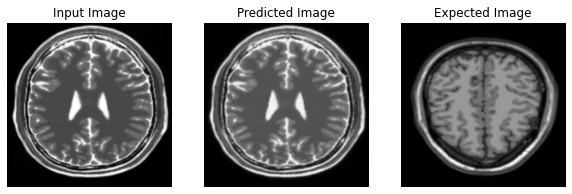

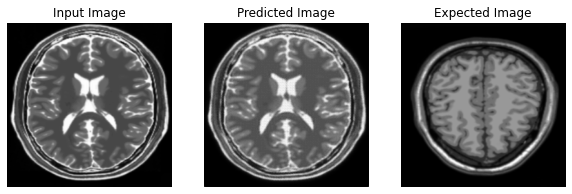

In [38]:
# Runing the trained model on the test dataset
for inp in tr2_dat.take(5):
    generate_images(generator_f, inp, sample_tr1)

#####While the GAGN  model has been able to produce the images its accuracy could be further improving the GPU.  This will allow us to reach much better transformation.